- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=2

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=2


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [5]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 16  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric"
)
print(datestring)

cifar10_1.0_1024_16____2020_08_06_23_29_03_406042__learned-metric


### Load packages

In [6]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [7]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [8]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [9]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [10]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [11]:
batch_size = 256

In [12]:
labeled_batch_size = 128
labeled_iter = create_classification_iterator(X_labeled, Y_labeled, labeled_batch_size)

In [13]:
X, y = next(iter(labeled_iter))

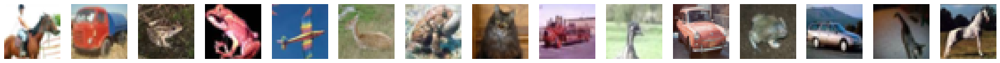

In [14]:
# view augmentations
nex = 15
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [15]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [16]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [17]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [18]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [19]:
from umap import UMAP

In [20]:
from tfumap.paths import MODEL_DIR

In [21]:
load_loc = "cifar10_0.0_1024_16____2020_07_31_17_42_43_175915"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [22]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [23]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [24]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [25]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.2935


In [26]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 23:29:34 2020 Finding Nearest Neighbors
Thu Aug  6 23:29:34 2020 Building RP forest with 10 trees
Thu Aug  6 23:29:36 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 23:29:49 2020 Finished Nearest Neighbor Search
Thu Aug  6 23:29:53 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 23:30:15 2020 Finished embedding


In [27]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 23:30:20 2020 Finding Nearest Neighbors
Thu Aug  6 23:30:20 2020 Building RP forest with 9 trees
Thu Aug  6 23:30:20 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 23:30:21 2020 Finished Nearest Neighbor Search
Thu Aug  6 23:30:21 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 23:30:38 2020 Finished embedding


In [28]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

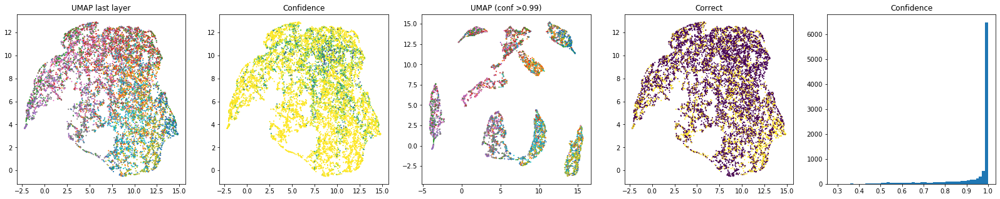

In [29]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [30]:
len(z_pred[Y_valid])

10000

In [31]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

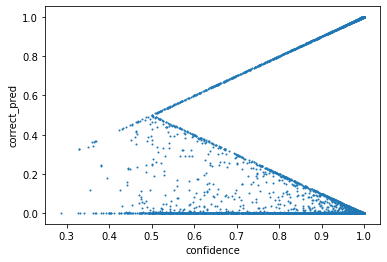

In [32]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [33]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [34]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [35]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [36]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [37]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


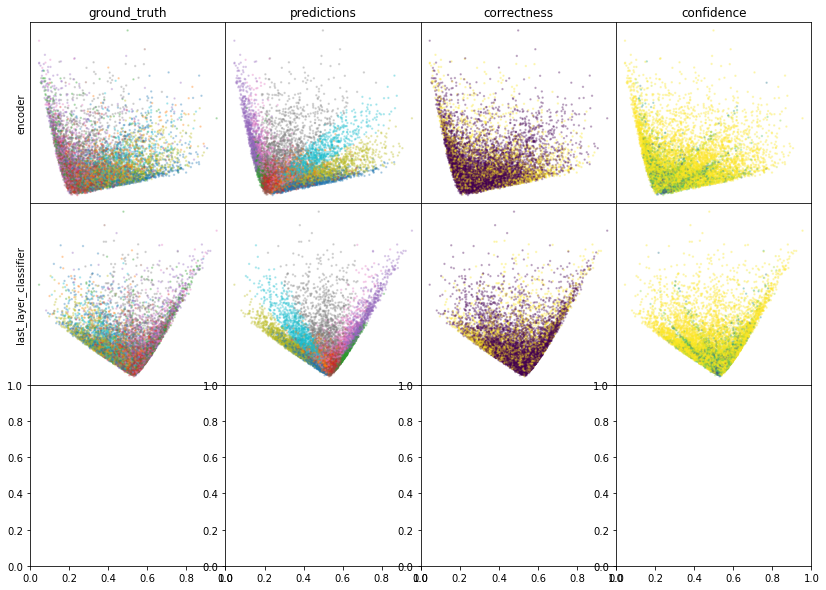

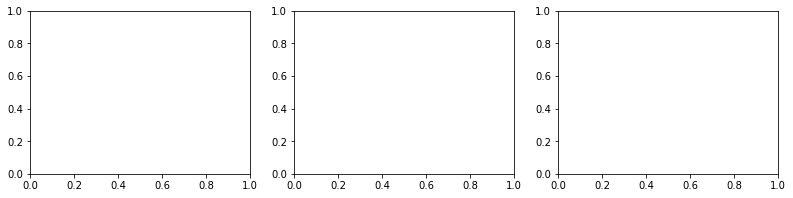

In [38]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [39]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [40]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [41]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [42]:
from tfumap.paths import MODEL_DIR

In [43]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [44]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [45]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

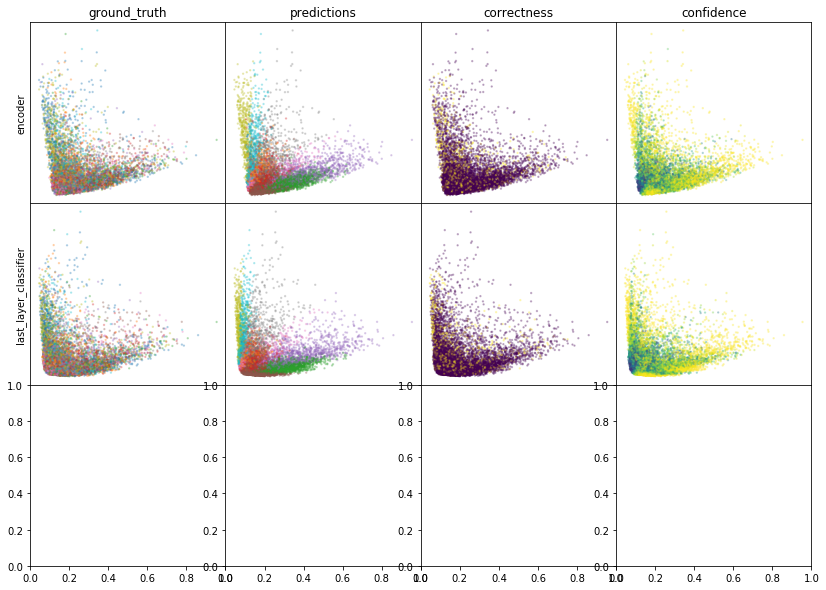

W0806 23:31:50.548161 139864680597248 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 23:31:50.685706 139864680597248 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 23:31:50.743966 139864680597248 legend.py:1282] No handles with labels found to put in legend.


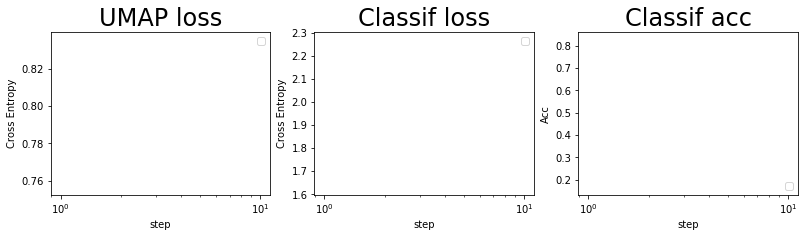

batch: 0 | train acc: 0.8281 | val acc: 0.1641
saving weights | batch = 100 | acc = 22.865
saving weights | batch = 108 | acc = 23.387
saving weights | batch = 117 | acc = 23.934
saving weights | batch = 128 | acc = 24.461
saving weights | batch = 143 | acc = 24.992
saving weights | batch = 157 | acc = 25.517
saving weights | batch = 173 | acc = 26.026
saving weights | batch = 198 | acc = 26.537
saving weights | batch = 234 | acc = 27.064
saving weights | batch = 287 | acc = 27.58
saving weights | batch = 363 | acc = 28.081
saving weights | batch = 507 | acc = 28.598


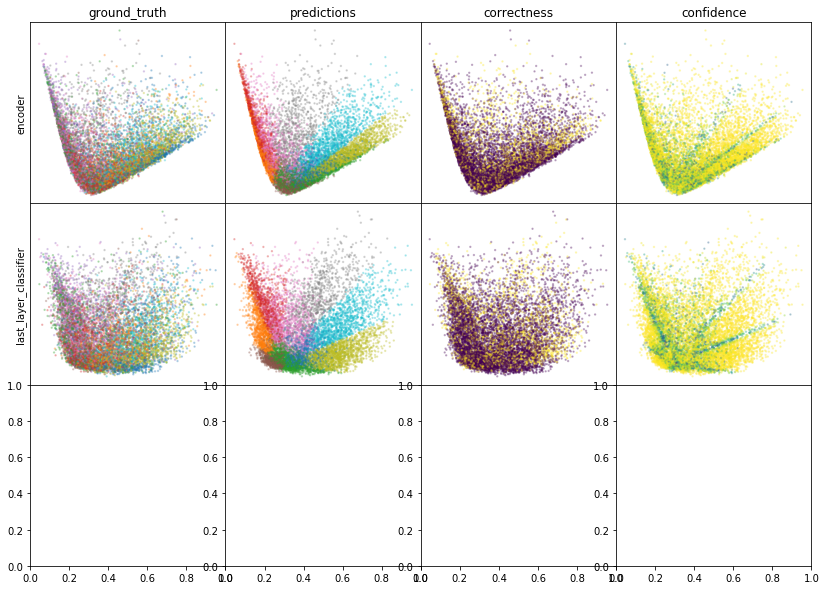

W0806 23:36:48.806546 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:36:48.869837 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:36:48.935453 139864680597248 legend.py:1282] No handles with labels found to put in legend.


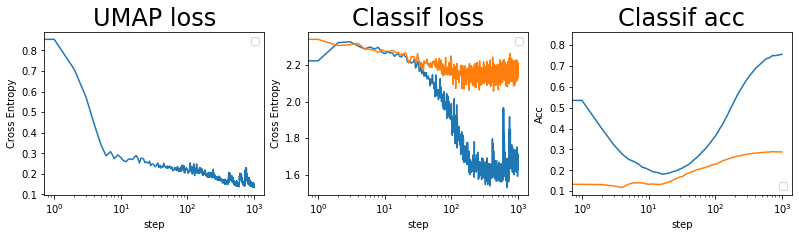

batch: 1000 | train acc: 0.7566 | val acc: 0.2881
saving weights | batch = 1942 | acc = 29.1


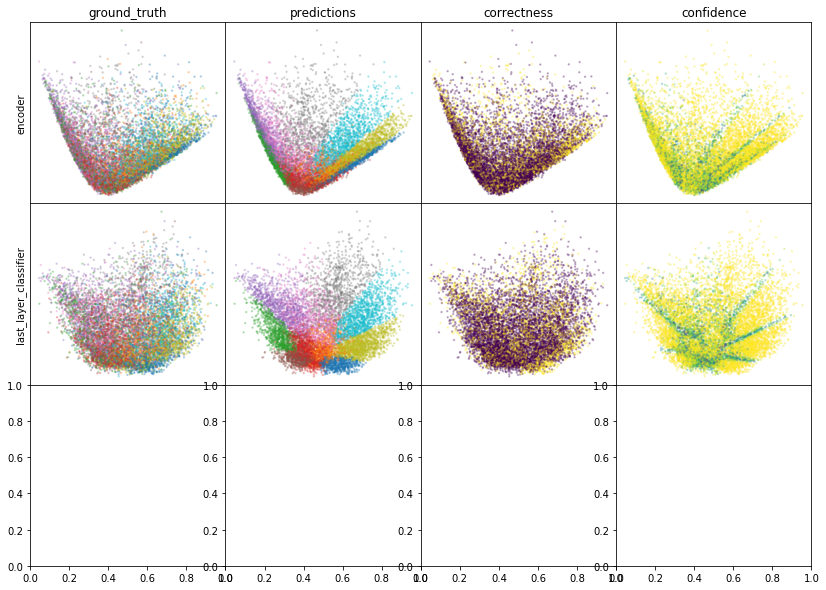

W0806 23:41:48.565992 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:41:48.631114 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:41:48.699819 139864680597248 legend.py:1282] No handles with labels found to put in legend.


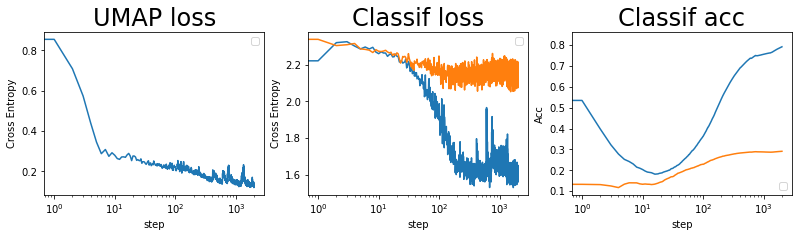

batch: 2000 | train acc: 0.7924 | val acc: 0.2913


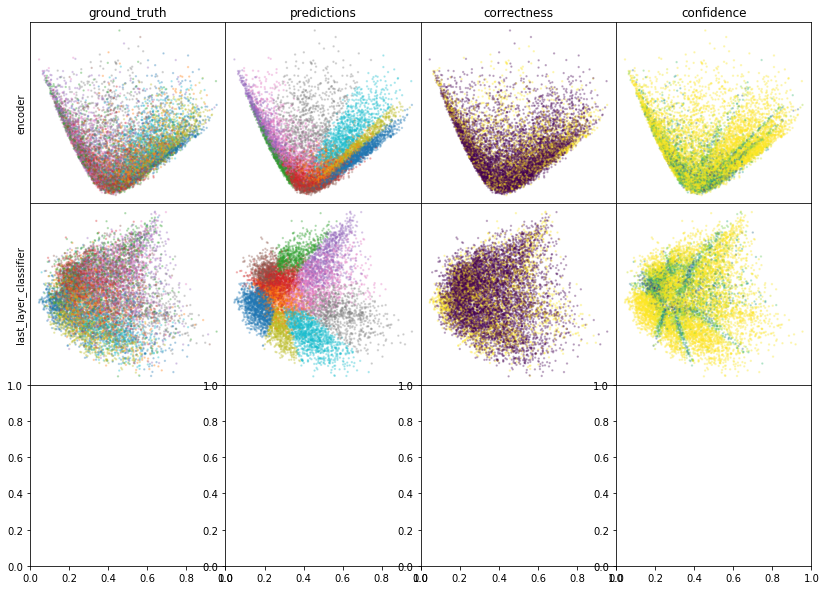

W0806 23:46:51.150903 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:46:51.227206 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:46:51.302718 139864680597248 legend.py:1282] No handles with labels found to put in legend.


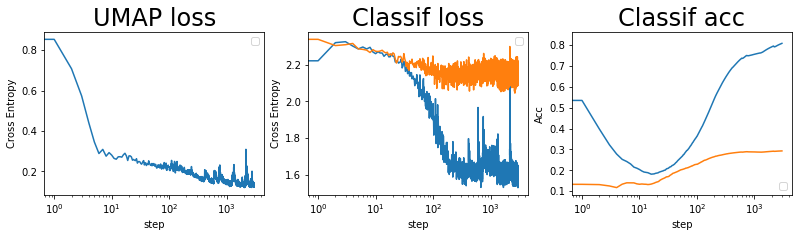

batch: 3000 | train acc: 0.8088 | val acc: 0.293


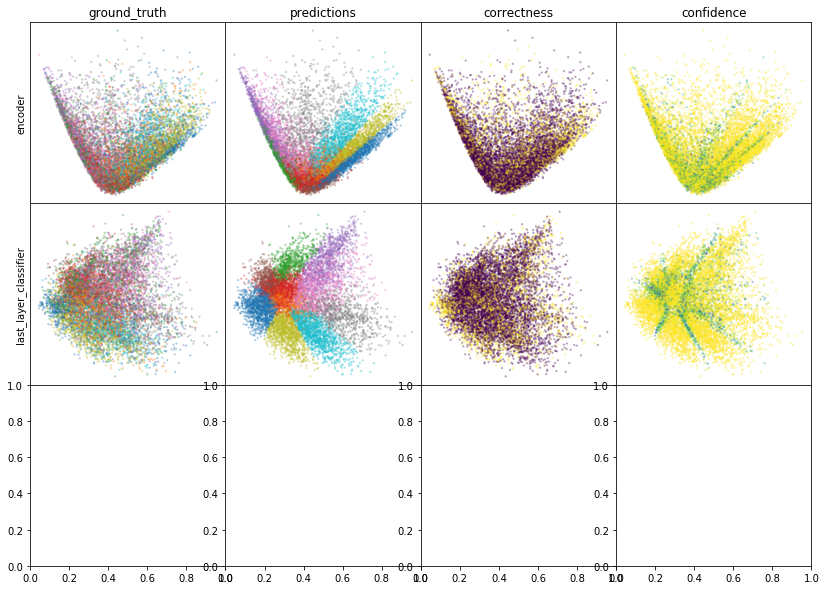

W0806 23:51:49.358707 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:51:49.435687 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:51:49.509453 139864680597248 legend.py:1282] No handles with labels found to put in legend.


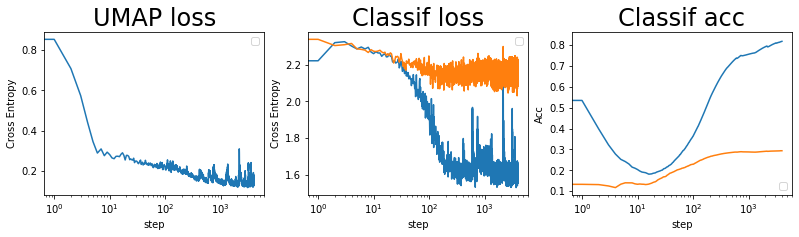

batch: 4000 | train acc: 0.8185 | val acc: 0.2939


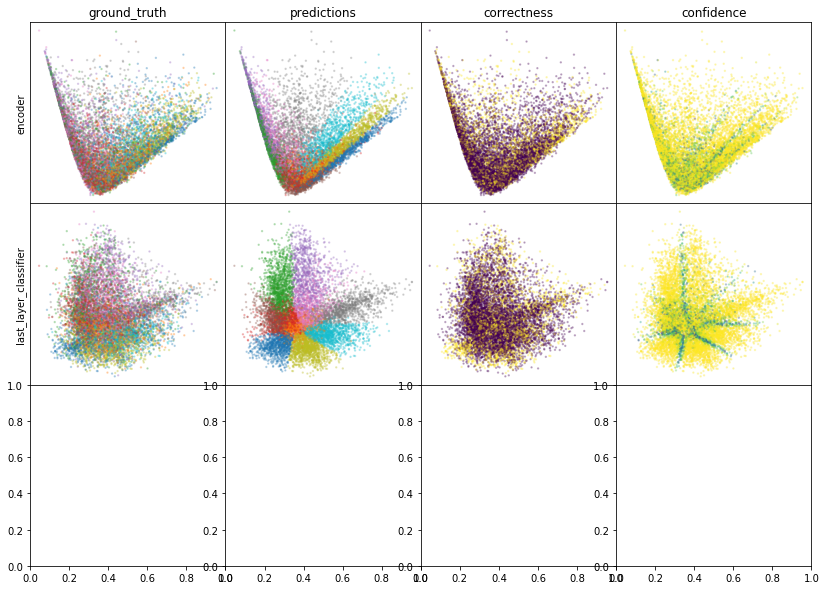

W0806 23:56:49.265322 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:56:49.338501 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0806 23:56:49.414845 139864680597248 legend.py:1282] No handles with labels found to put in legend.


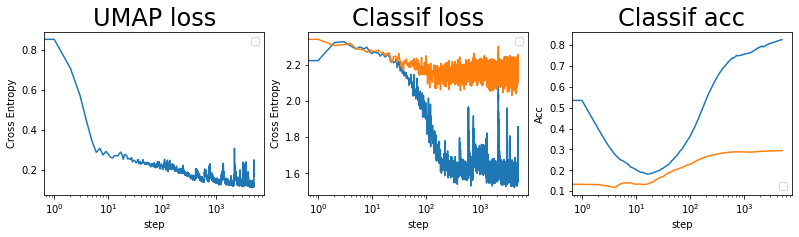

batch: 5000 | train acc: 0.8262 | val acc: 0.2944


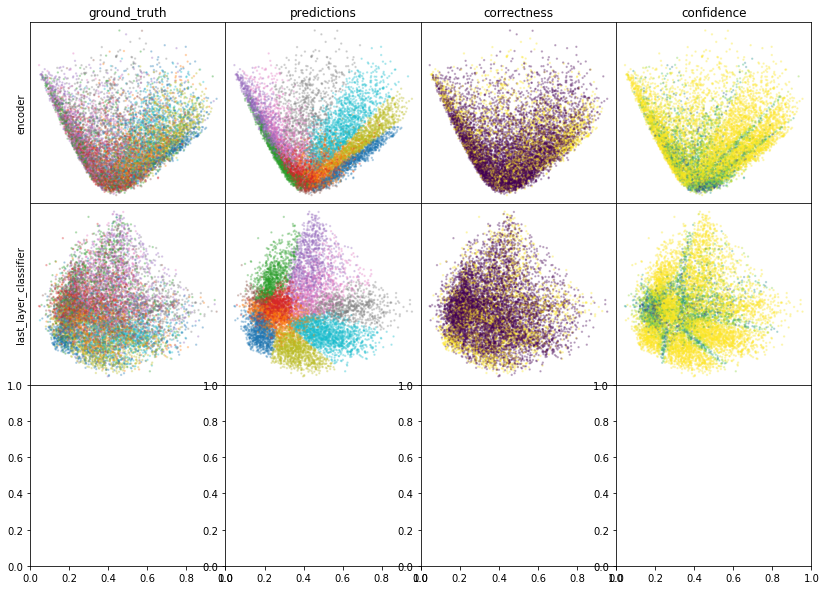

W0807 00:01:49.783309 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:01:49.863725 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:01:49.958156 139864680597248 legend.py:1282] No handles with labels found to put in legend.


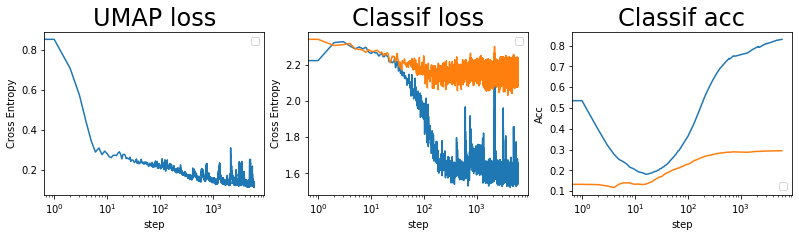

batch: 6000 | train acc: 0.8302 | val acc: 0.2945


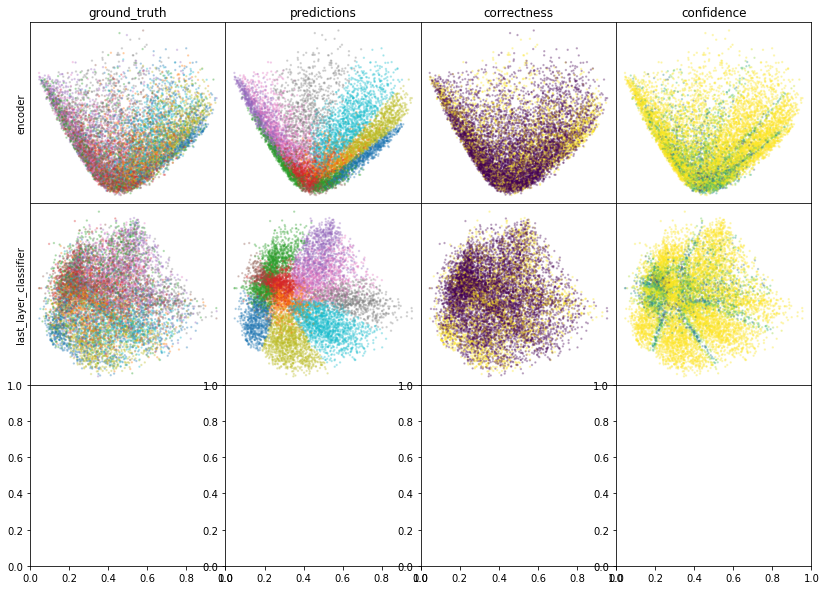

W0807 00:06:49.993597 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:06:50.070095 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:06:50.152608 139864680597248 legend.py:1282] No handles with labels found to put in legend.


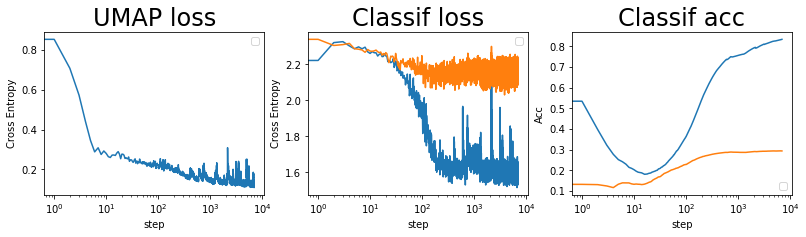

batch: 7000 | train acc: 0.8346 | val acc: 0.2945


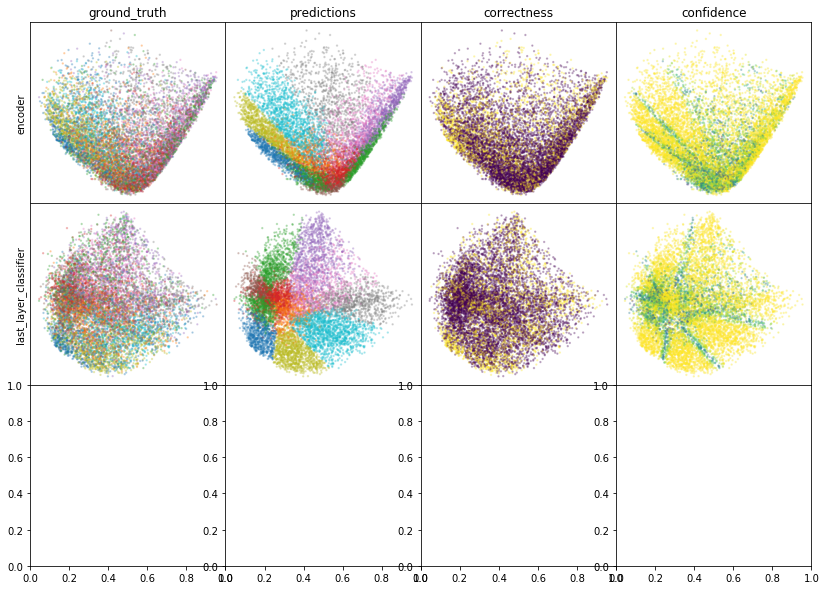

W0807 00:11:51.657079 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:11:51.738894 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:11:51.822538 139864680597248 legend.py:1282] No handles with labels found to put in legend.


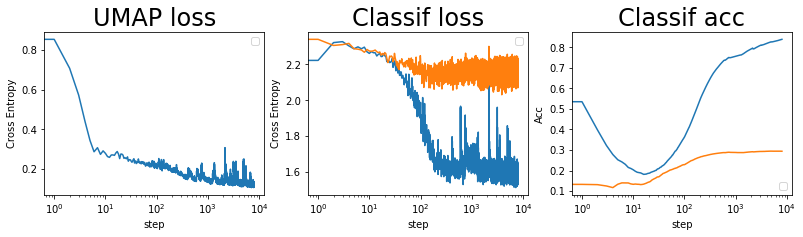

batch: 8000 | train acc: 0.8388 | val acc: 0.2941


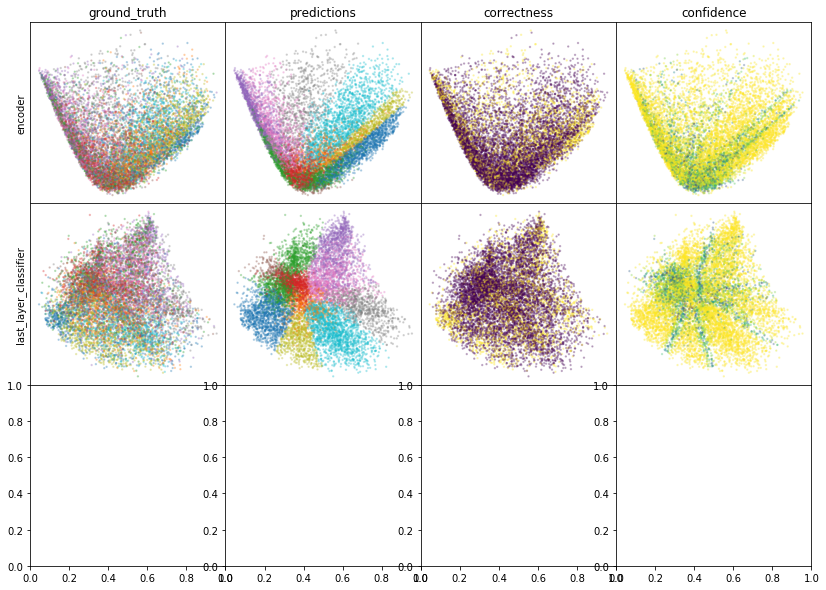

W0807 00:16:47.445703 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:16:47.530854 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:16:47.616546 139864680597248 legend.py:1282] No handles with labels found to put in legend.


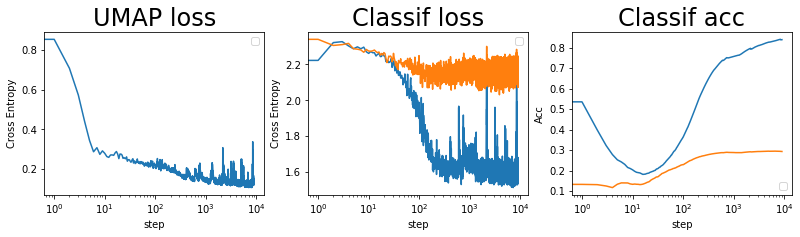

batch: 9000 | train acc: 0.8383 | val acc: 0.2932


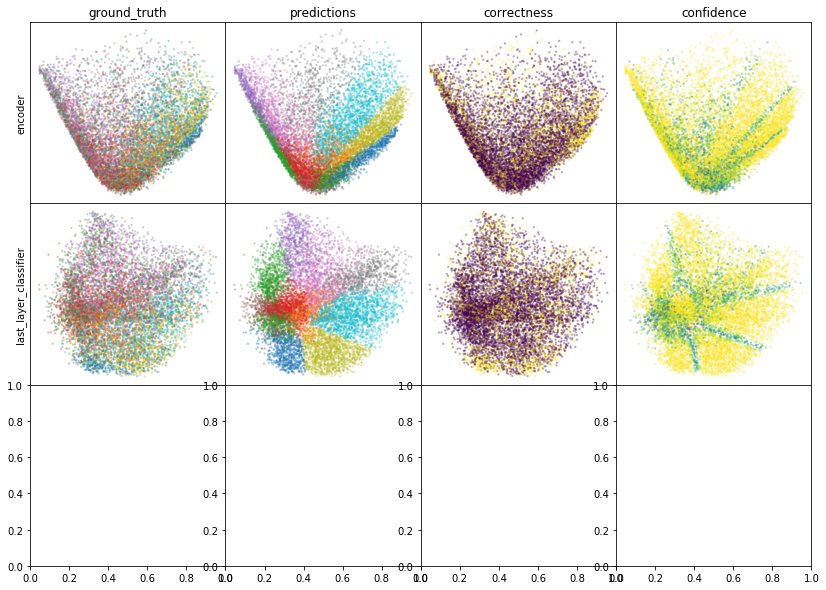

W0807 00:21:44.949095 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:21:45.038194 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:21:45.130743 139864680597248 legend.py:1282] No handles with labels found to put in legend.


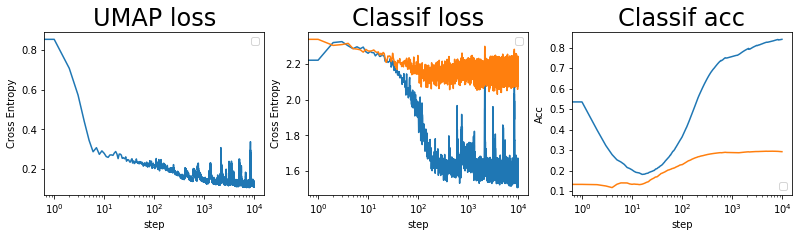

batch: 10000 | train acc: 0.8406 | val acc: 0.2924


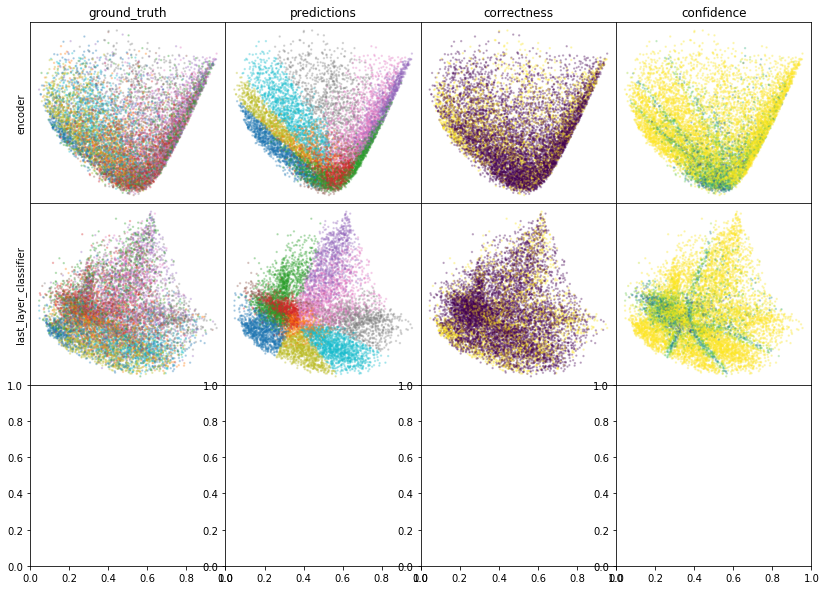

W0807 00:26:34.084603 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:26:34.173801 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:26:34.267318 139864680597248 legend.py:1282] No handles with labels found to put in legend.


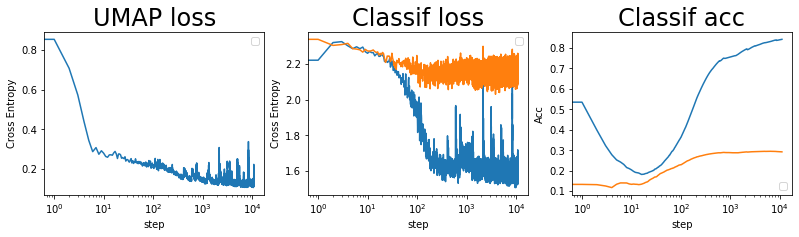

batch: 11000 | train acc: 0.8427 | val acc: 0.2921


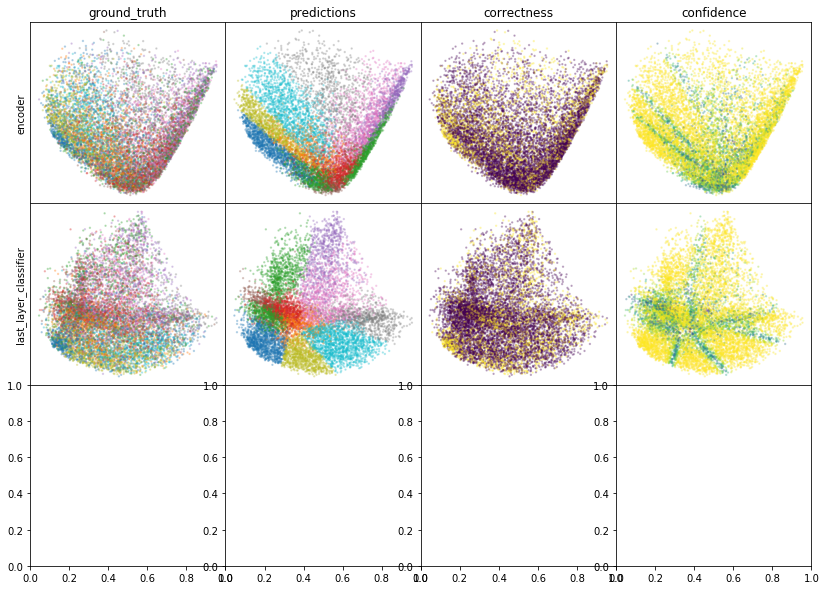

W0807 00:31:22.426720 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:31:22.523101 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:31:22.614964 139864680597248 legend.py:1282] No handles with labels found to put in legend.


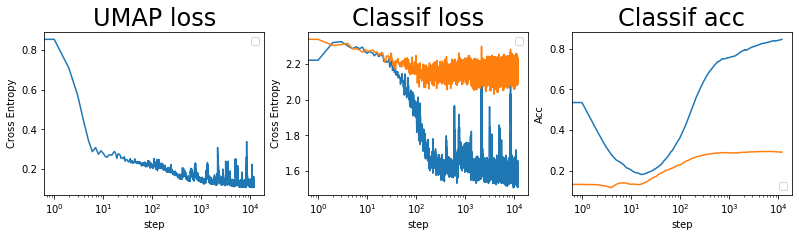

batch: 12000 | train acc: 0.8459 | val acc: 0.2915


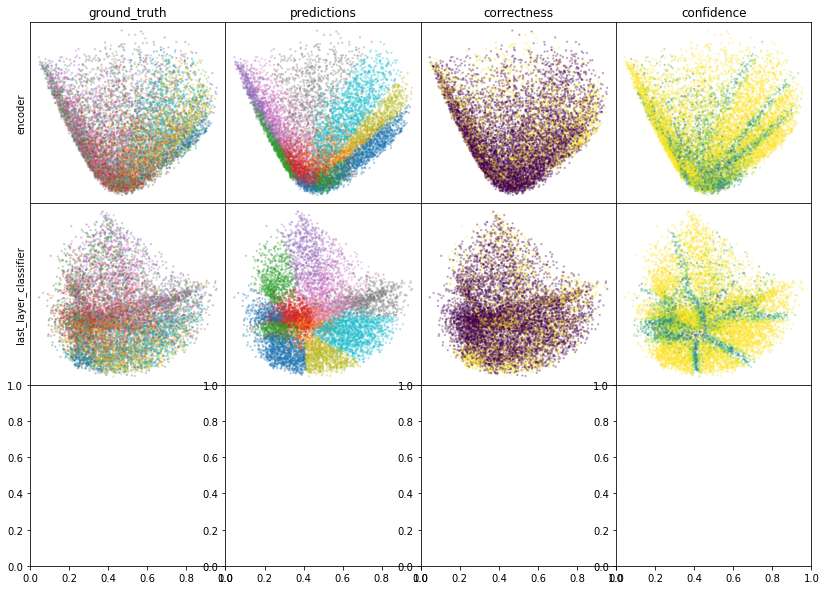

W0807 00:36:10.530448 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:36:10.629635 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:36:10.727712 139864680597248 legend.py:1282] No handles with labels found to put in legend.


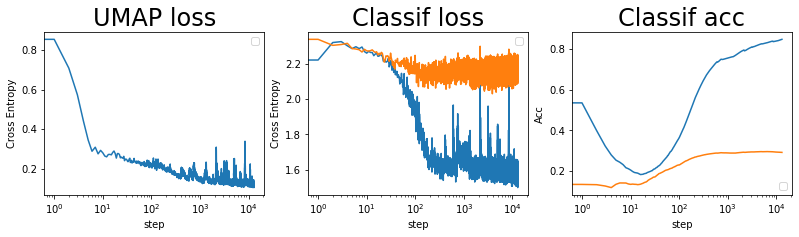

batch: 13000 | train acc: 0.8487 | val acc: 0.2908


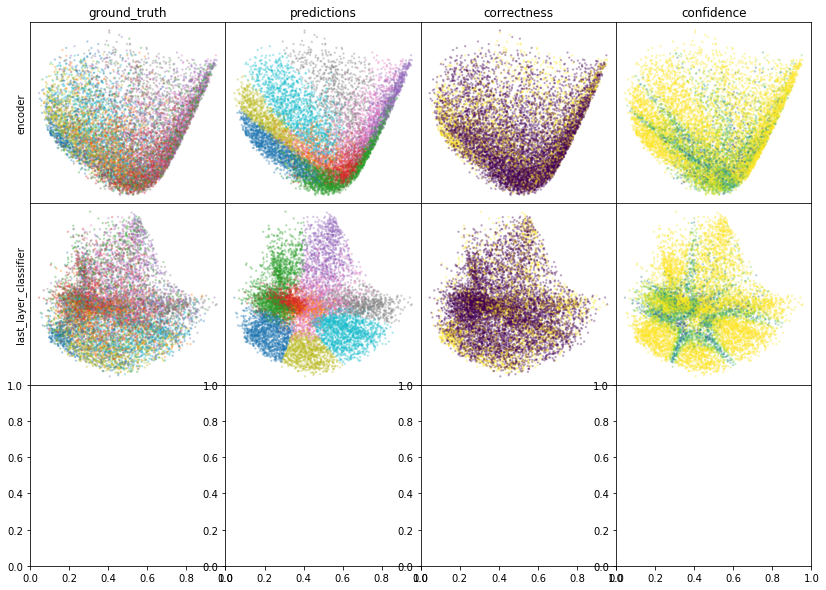

W0807 00:41:09.396591 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:41:09.499390 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:41:09.600824 139864680597248 legend.py:1282] No handles with labels found to put in legend.


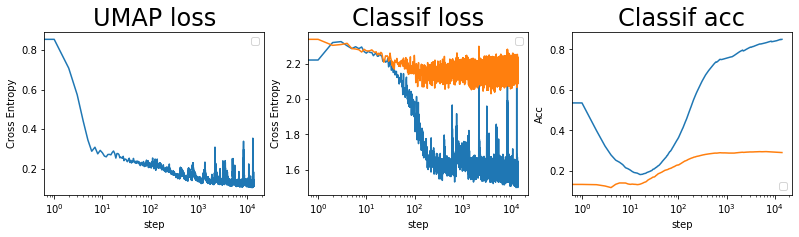

batch: 14000 | train acc: 0.8492 | val acc: 0.2902


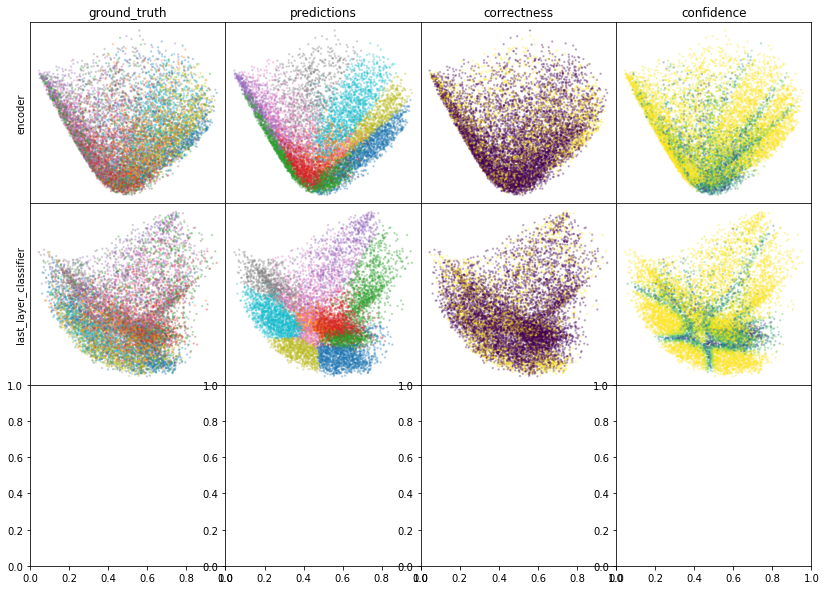

W0807 00:46:07.757407 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:46:07.863167 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:46:07.966933 139864680597248 legend.py:1282] No handles with labels found to put in legend.


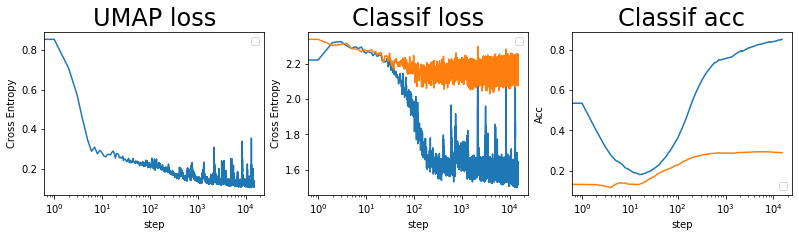

batch: 15000 | train acc: 0.8516 | val acc: 0.2896


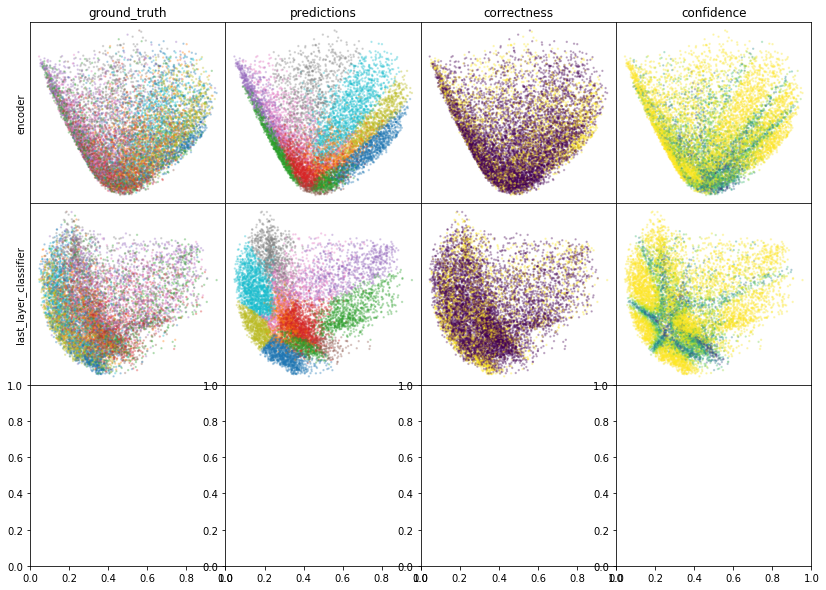

W0807 00:50:54.977444 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:50:55.082693 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:50:55.188537 139864680597248 legend.py:1282] No handles with labels found to put in legend.


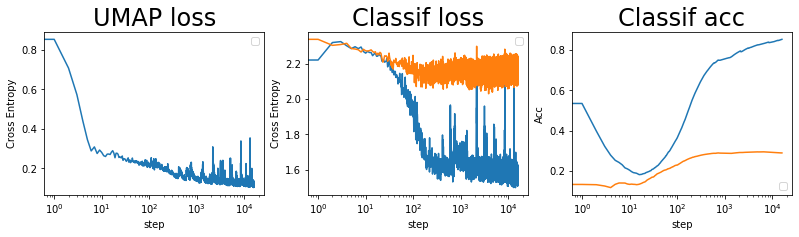

batch: 16000 | train acc: 0.8538 | val acc: 0.2895
leaving epoch because no improvement in 10000 batches


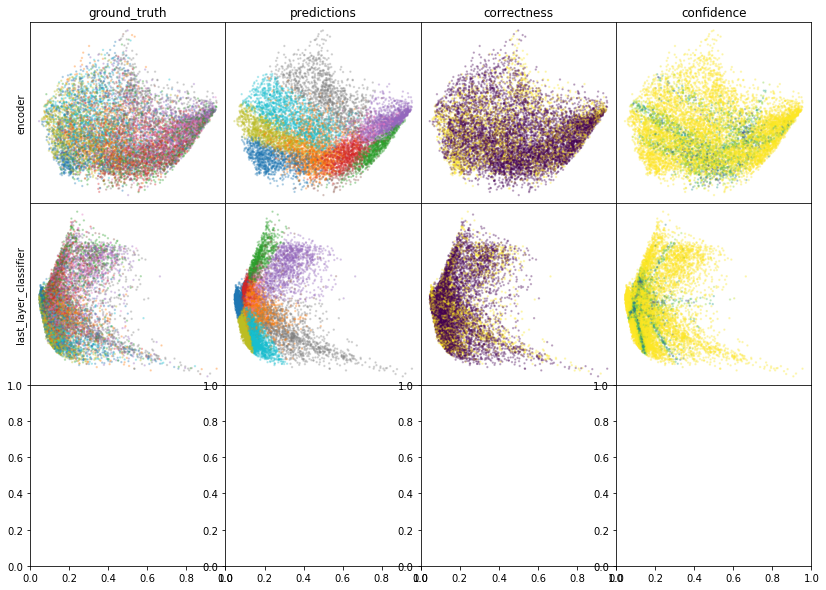

W0807 00:55:58.641853 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:55:58.749313 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 00:55:58.874336 139864680597248 legend.py:1282] No handles with labels found to put in legend.


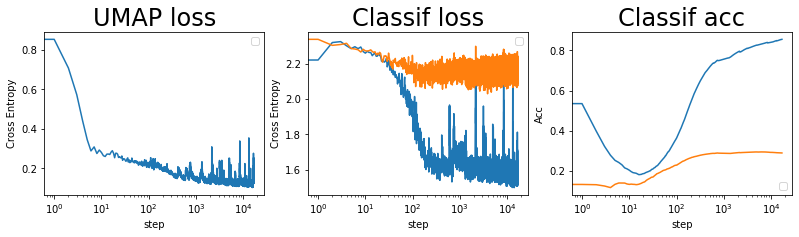

batch: 17000 | train acc: 0.8552 | val acc: 0.2896


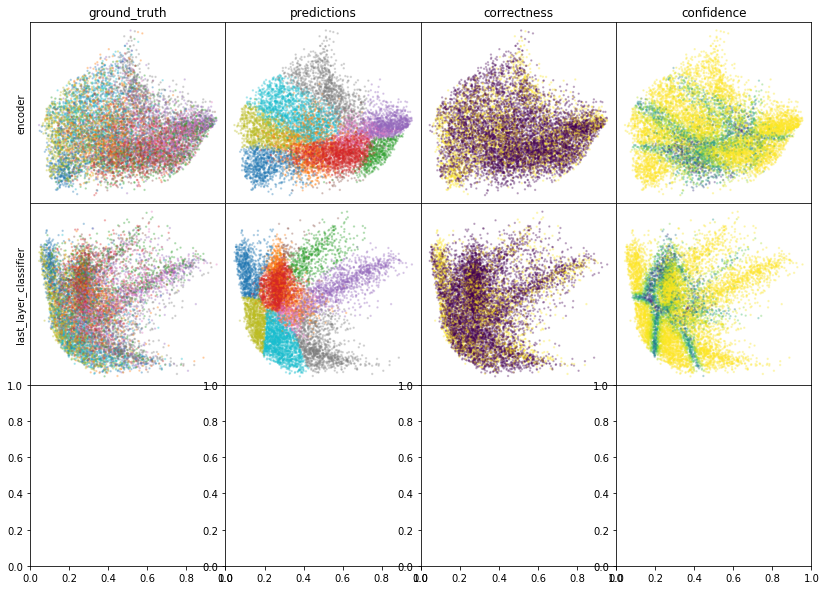

W0807 01:00:44.695526 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:00:44.808050 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:00:44.917766 139864680597248 legend.py:1282] No handles with labels found to put in legend.


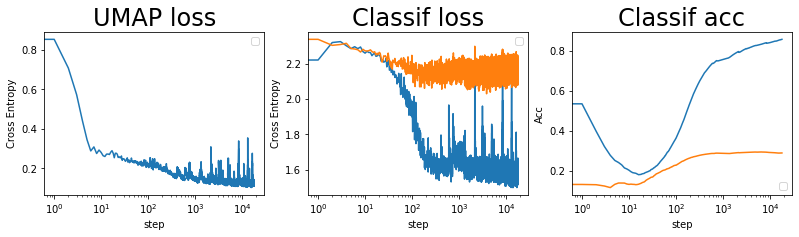

batch: 18000 | train acc: 0.857 | val acc: 0.29


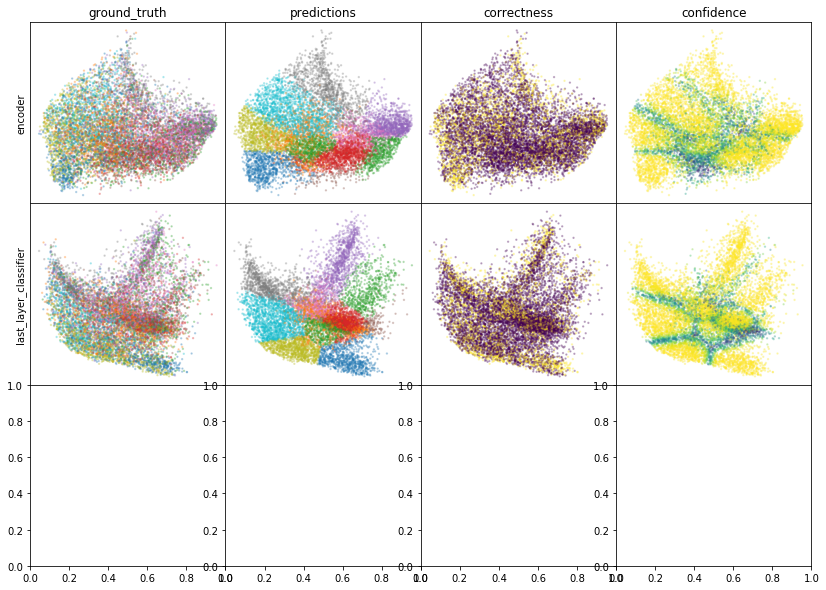

W0807 01:05:43.621817 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:05:43.757888 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:05:43.870054 139864680597248 legend.py:1282] No handles with labels found to put in legend.


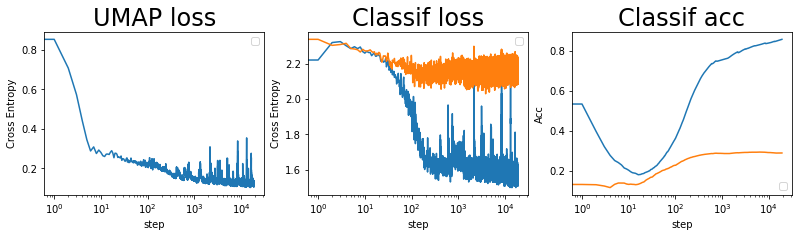

batch: 19000 | train acc: 0.8588 | val acc: 0.2903


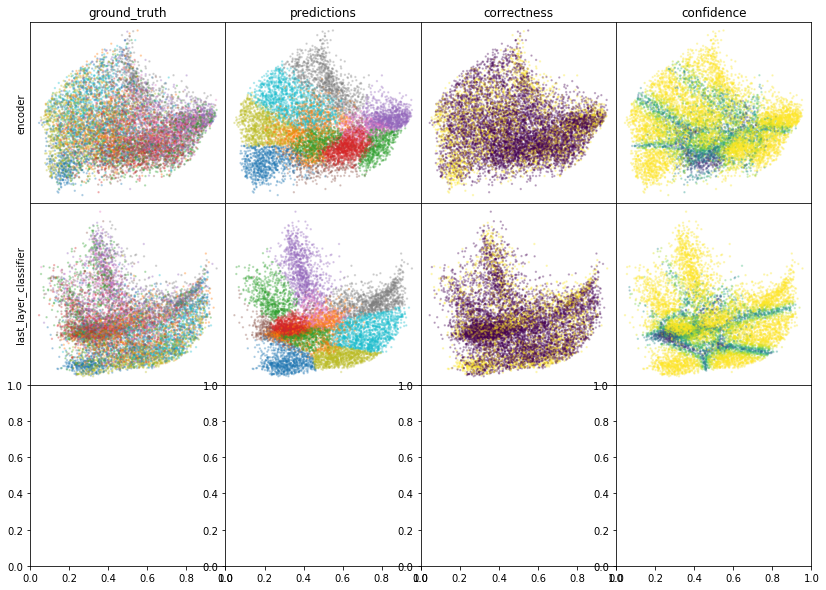

W0807 01:10:43.806614 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:10:43.925630 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:10:44.043817 139864680597248 legend.py:1282] No handles with labels found to put in legend.


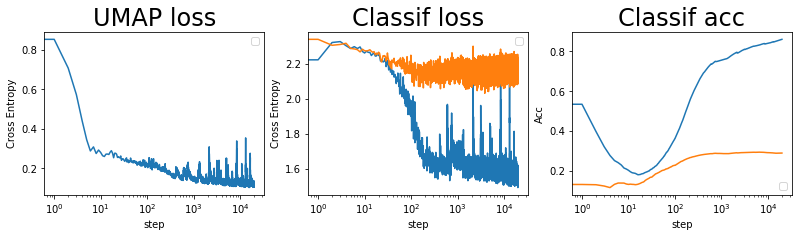

batch: 20000 | train acc: 0.8608 | val acc: 0.2904


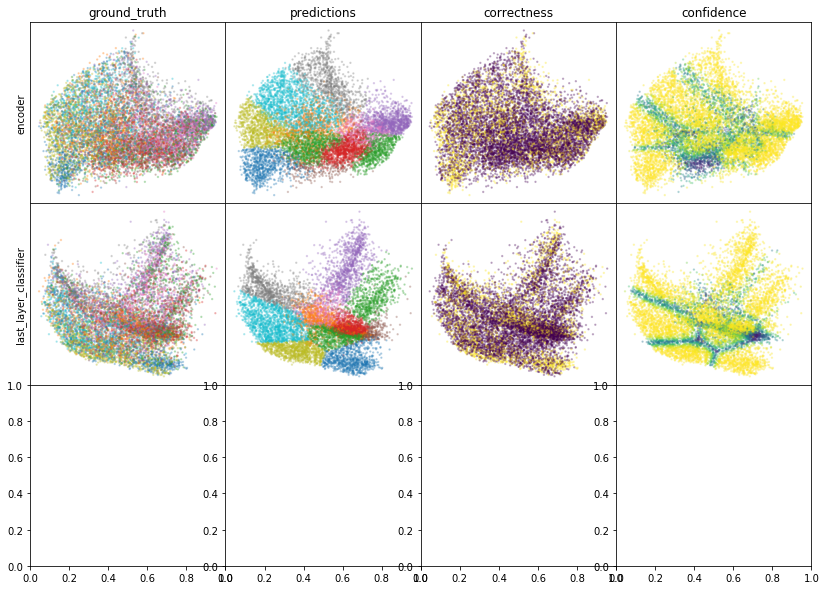

W0807 01:15:29.851001 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:15:29.991592 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:15:30.112056 139864680597248 legend.py:1282] No handles with labels found to put in legend.


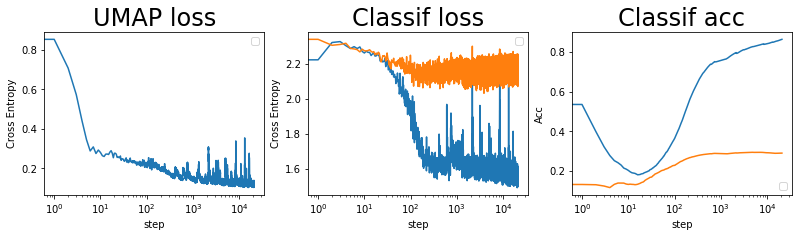

batch: 21000 | train acc: 0.8627 | val acc: 0.2905


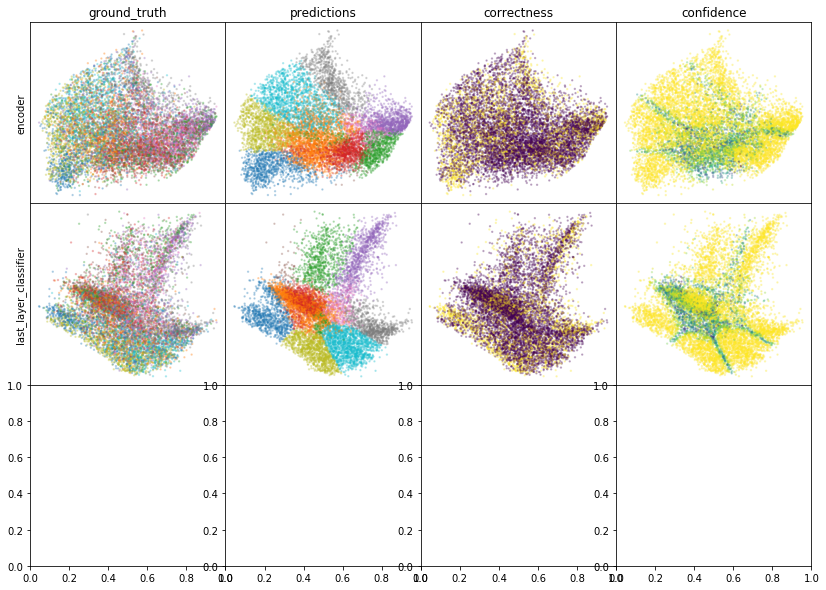

W0807 01:25:14.267791 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:25:14.399822 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:25:14.522784 139864680597248 legend.py:1282] No handles with labels found to put in legend.


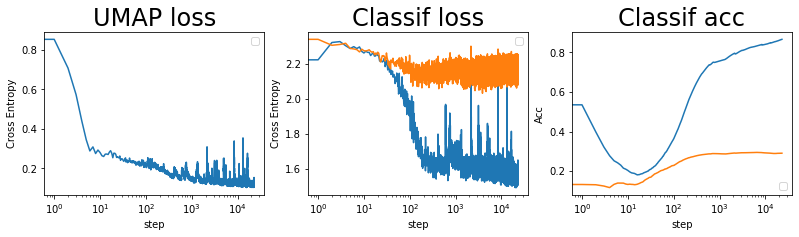

batch: 23000 | train acc: 0.8659 | val acc: 0.2908


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



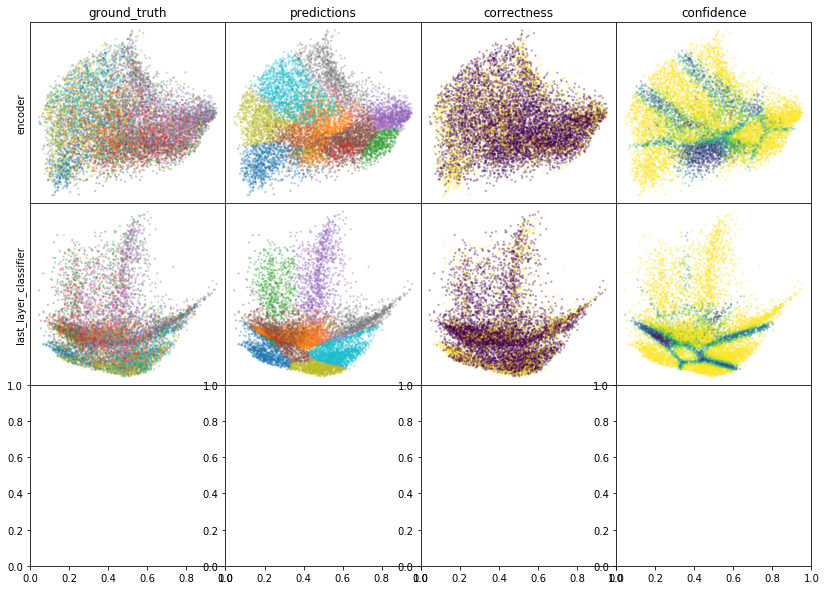

W0807 01:39:48.769092 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:39:48.913229 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:39:49.062169 139864680597248 legend.py:1282] No handles with labels found to put in legend.


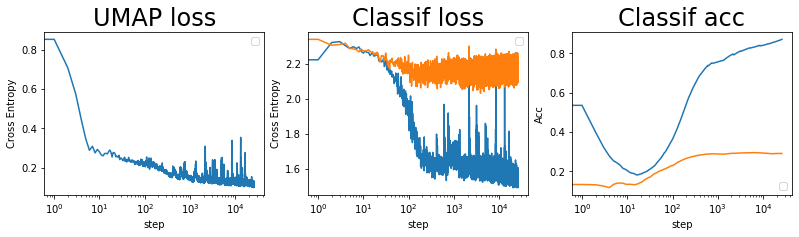

batch: 26000 | train acc: 0.8707 | val acc: 0.2906


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



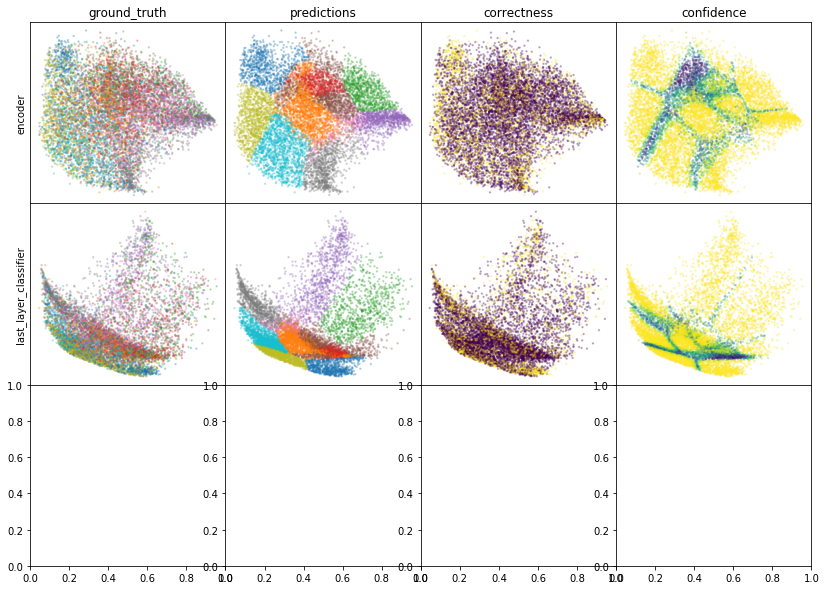

W0807 01:54:54.904665 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:54:55.075104 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 01:54:55.226692 139864680597248 legend.py:1282] No handles with labels found to put in legend.


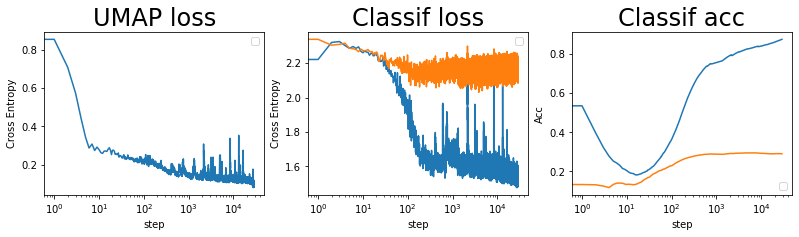

batch: 29000 | train acc: 0.875 | val acc: 0.2902


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



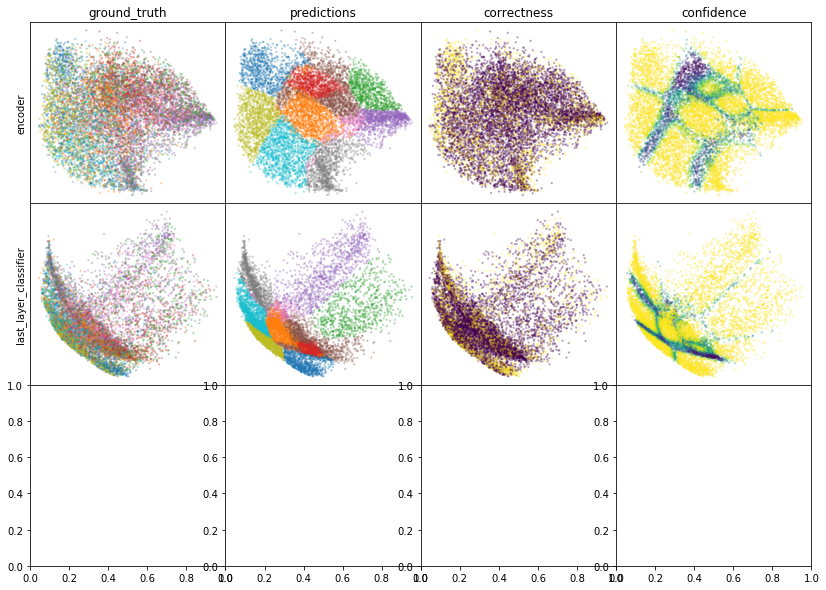

W0807 02:09:00.917787 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:09:01.078540 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:09:01.234722 139864680597248 legend.py:1282] No handles with labels found to put in legend.


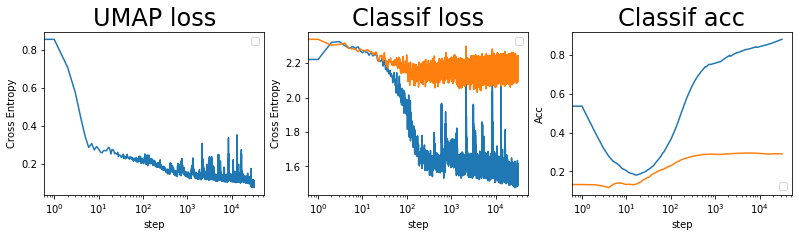

batch: 32000 | train acc: 0.8785 | val acc: 0.2898


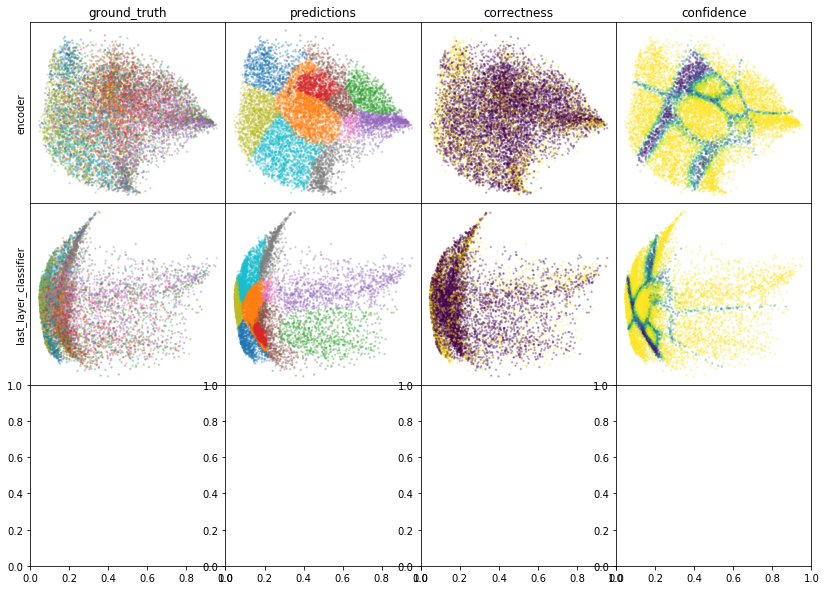

W0807 02:13:56.756272 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:13:56.921571 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:13:57.097568 139864680597248 legend.py:1282] No handles with labels found to put in legend.


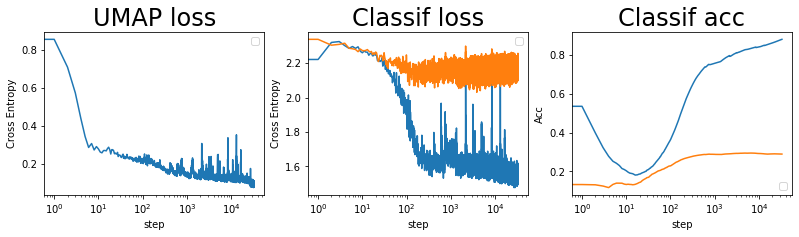

batch: 33000 | train acc: 0.8796 | val acc: 0.2895


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



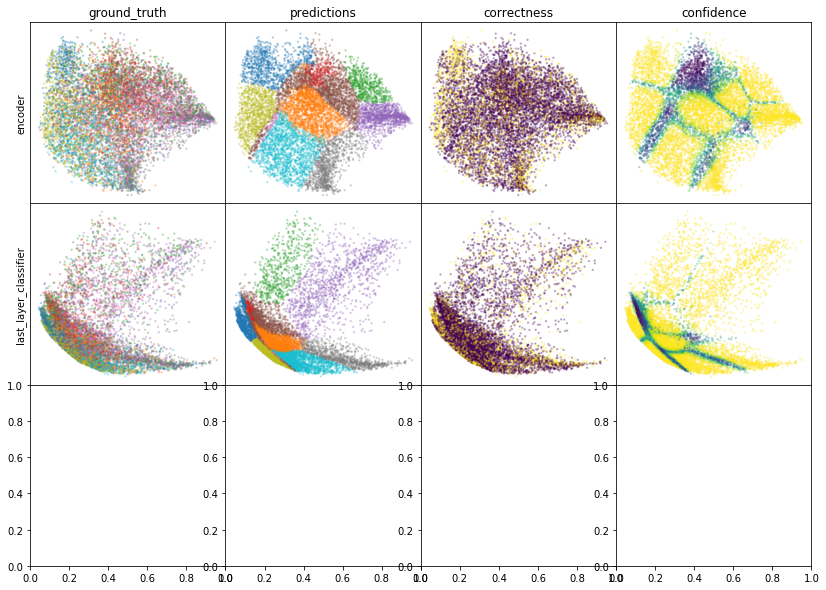

W0807 02:23:30.119498 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:23:30.296095 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:23:30.459109 139864680597248 legend.py:1282] No handles with labels found to put in legend.


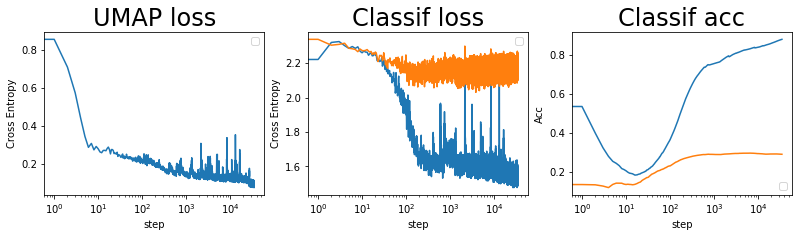

batch: 35000 | train acc: 0.8814 | val acc: 0.289


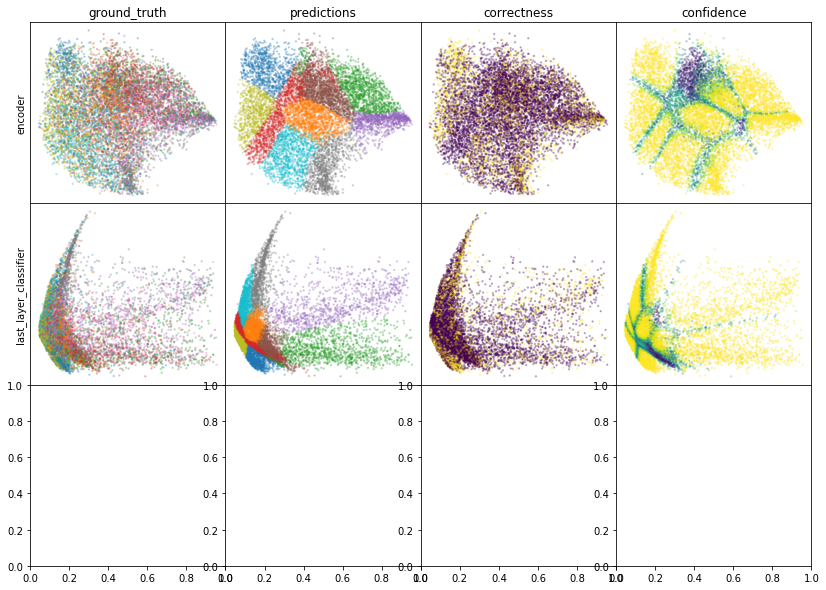

W0807 02:28:16.219100 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:28:16.397634 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:28:16.568207 139864680597248 legend.py:1282] No handles with labels found to put in legend.


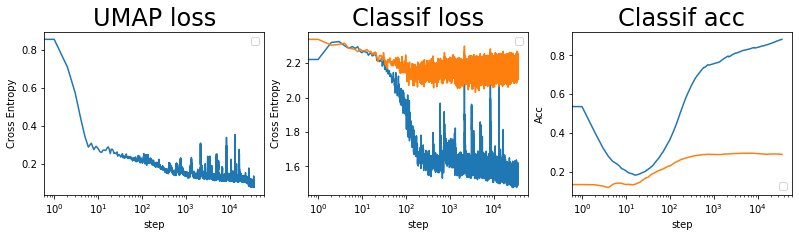

batch: 36000 | train acc: 0.8822 | val acc: 0.2884


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



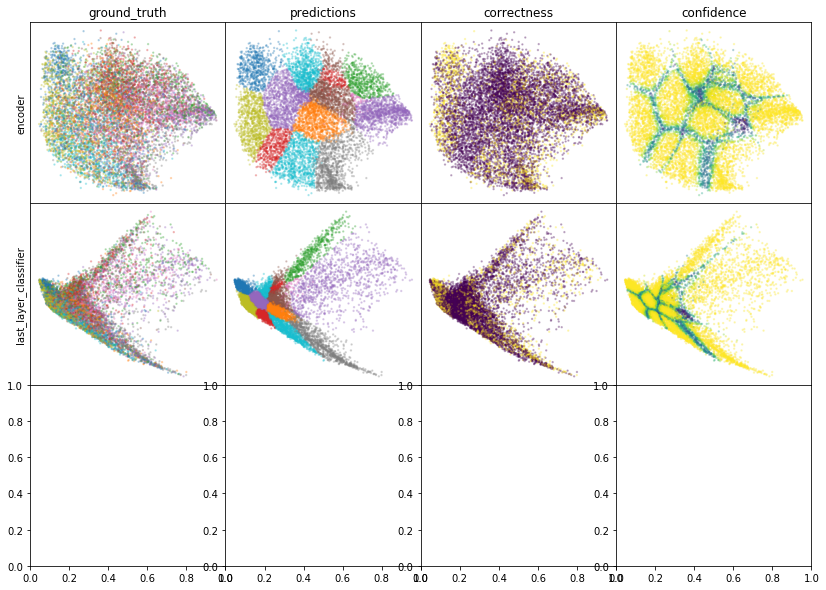

W0807 02:38:30.892409 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:38:31.075456 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:38:31.249209 139864680597248 legend.py:1282] No handles with labels found to put in legend.


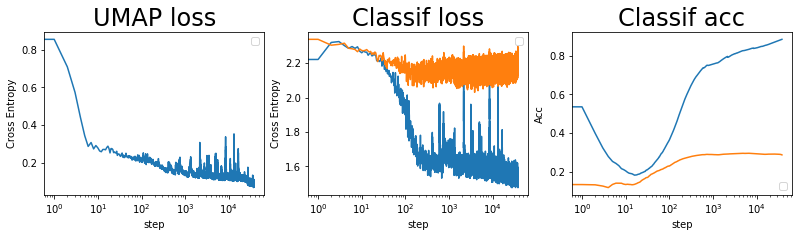

batch: 38000 | train acc: 0.8846 | val acc: 0.2865


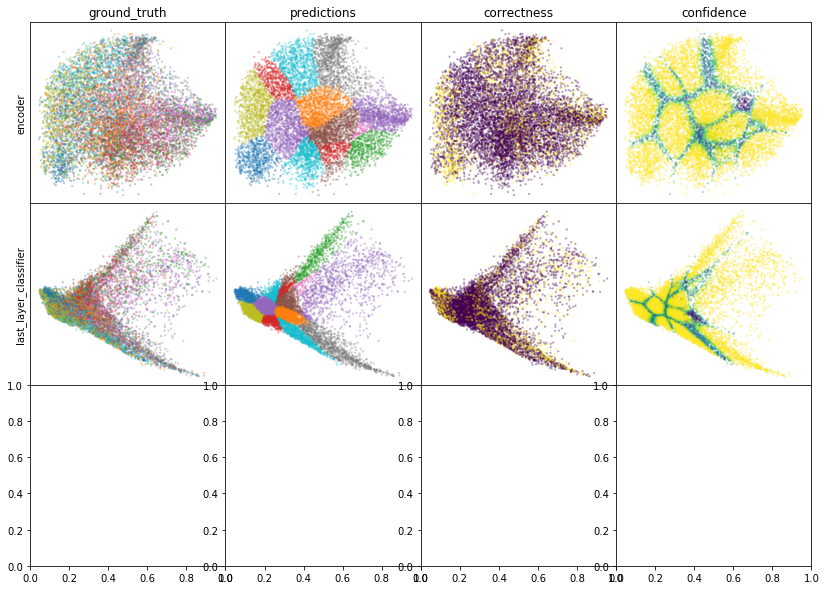

W0807 02:43:20.166722 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:43:20.354336 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:43:20.529113 139864680597248 legend.py:1282] No handles with labels found to put in legend.


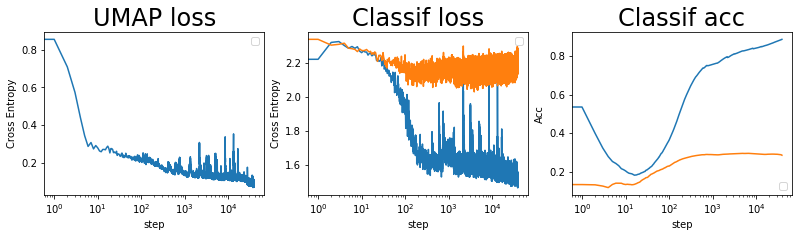

batch: 39000 | train acc: 0.8863 | val acc: 0.2851


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

W0807 02:52:49.198231 139864680597248 legend.py:1282] No handles with labels found to put in legend.


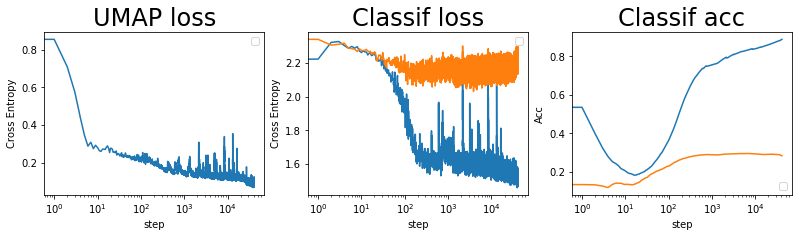

batch: 41000 | train acc: 0.8892 | val acc: 0.2825


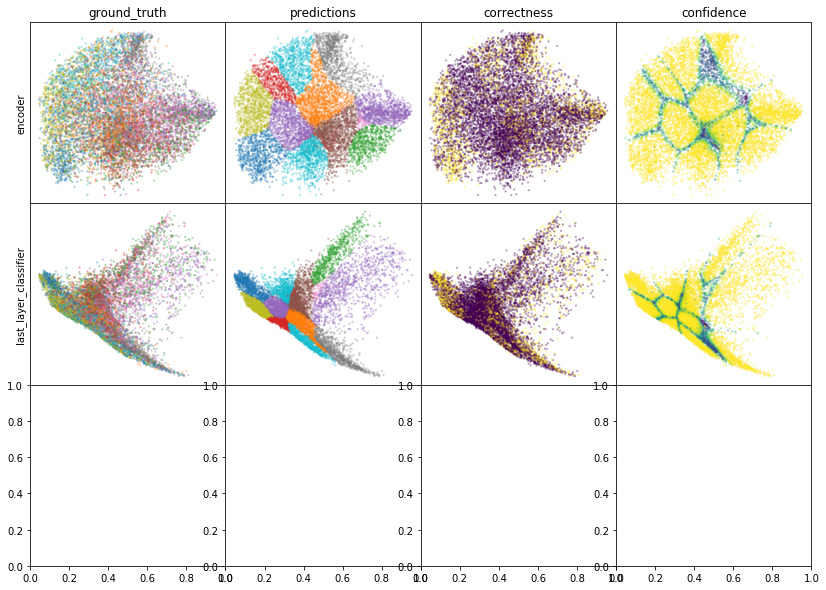

W0807 02:57:35.611825 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:57:35.810301 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 02:57:36.017358 139864680597248 legend.py:1282] No handles with labels found to put in legend.


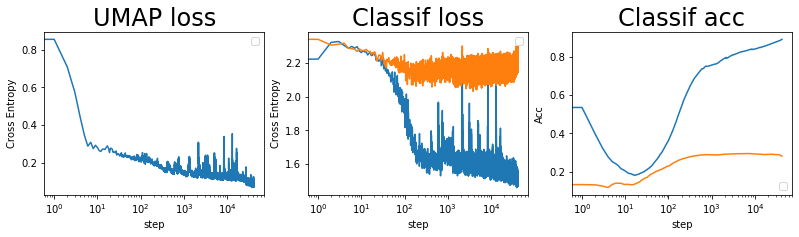

batch: 42000 | train acc: 0.8907 | val acc: 0.2813
batch 42247 | acc = 0.281 | learn rate = 0.0010000000474974513 | reloading weights from batch 1942 at acc 29 | n reloads = 0
batch 42348 | acc = 0.281 | learn rate = 0.0005000000237487257 | reloading weights from batch 1942 at acc 29 | n reloads = 1


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



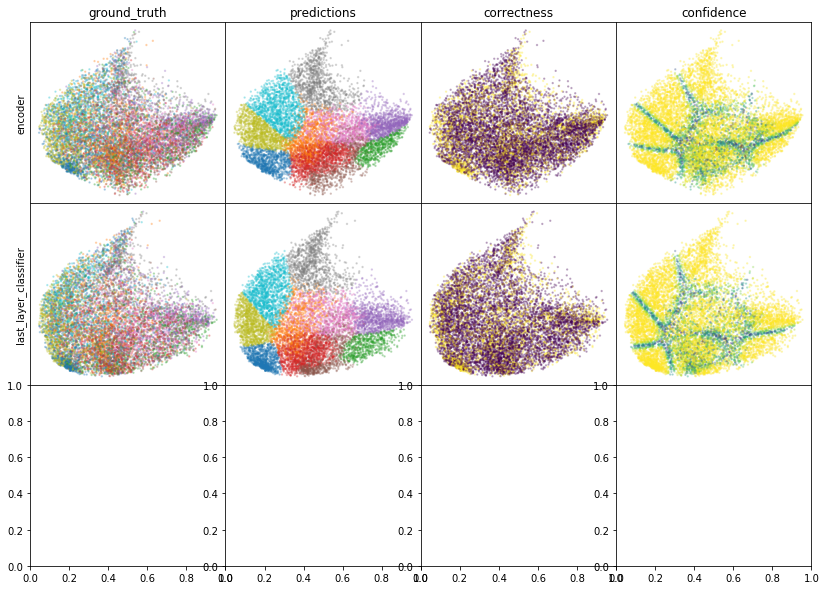

W0807 03:12:17.601007 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:12:17.816916 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:12:18.010182 139864680597248 legend.py:1282] No handles with labels found to put in legend.


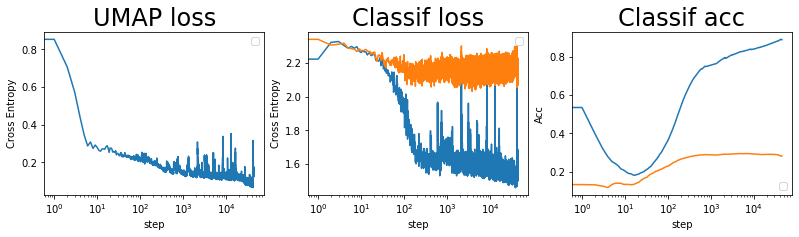

batch: 45000 | train acc: 0.8891 | val acc: 0.2822


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



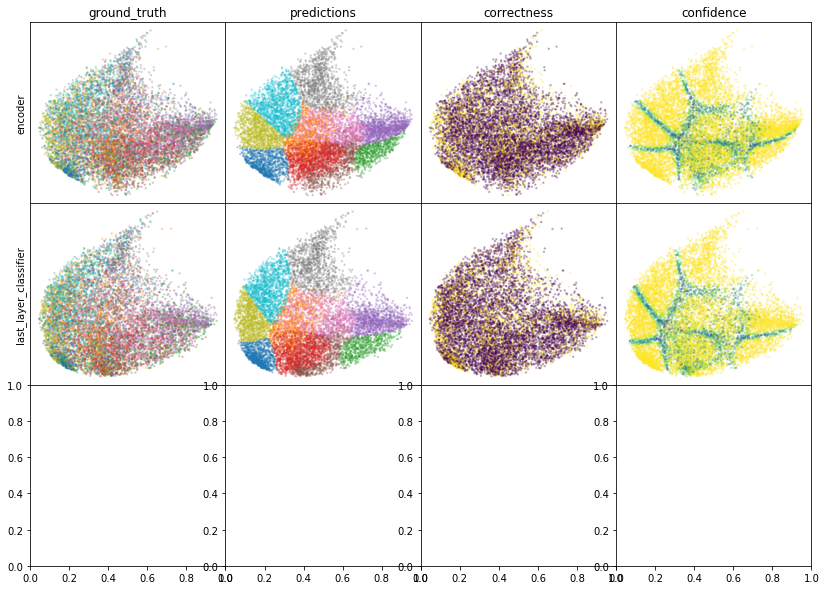

W0807 03:26:49.149577 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:26:49.396346 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:26:49.629667 139864680597248 legend.py:1282] No handles with labels found to put in legend.


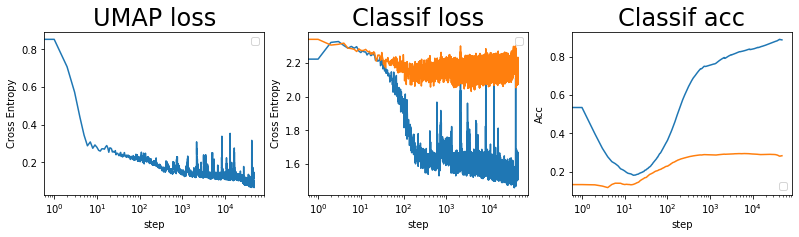

batch: 48000 | train acc: 0.8882 | val acc: 0.2834


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



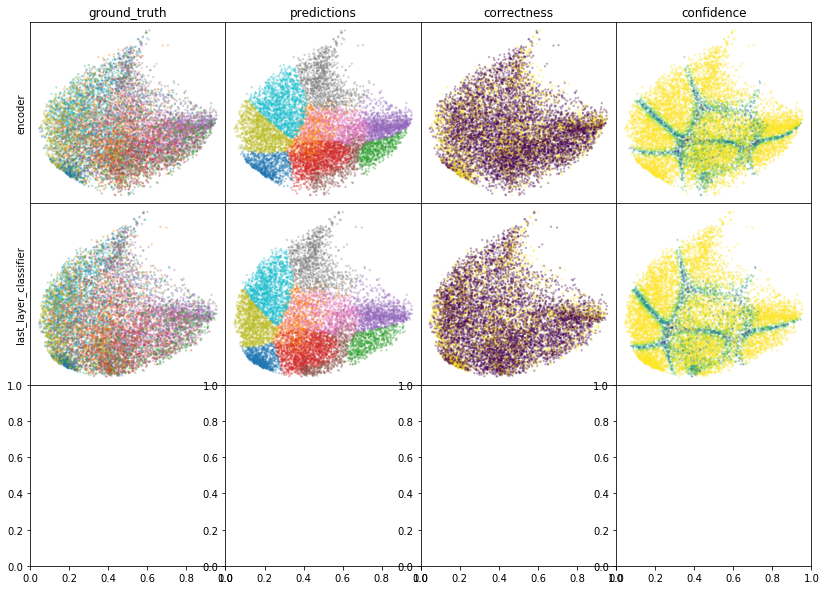

W0807 03:41:35.075613 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:41:35.312158 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:41:35.544985 139864680597248 legend.py:1282] No handles with labels found to put in legend.


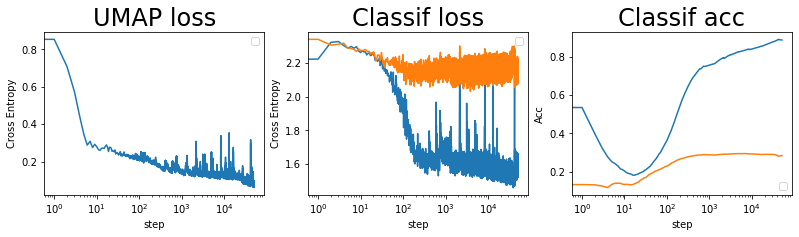

batch: 51000 | train acc: 0.8874 | val acc: 0.2845


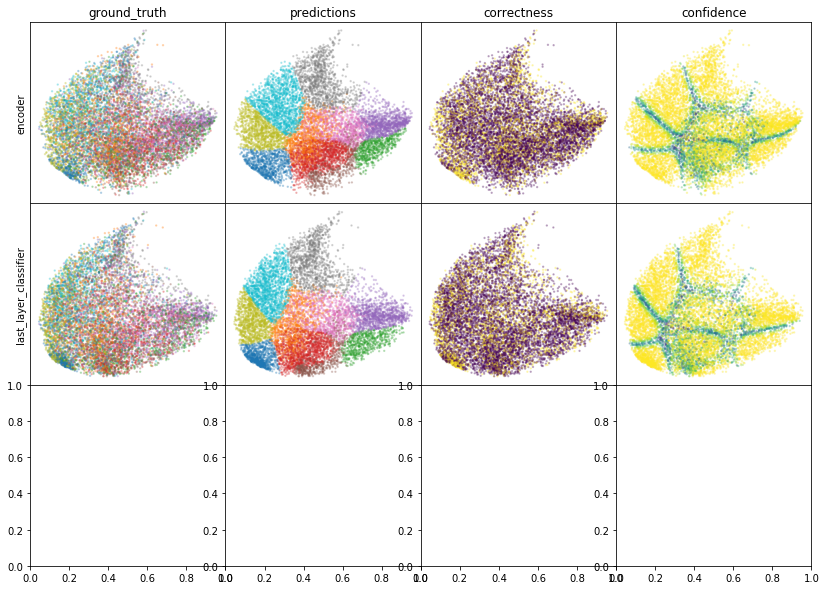

W0807 03:46:13.801496 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:46:14.032272 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:46:14.255070 139864680597248 legend.py:1282] No handles with labels found to put in legend.


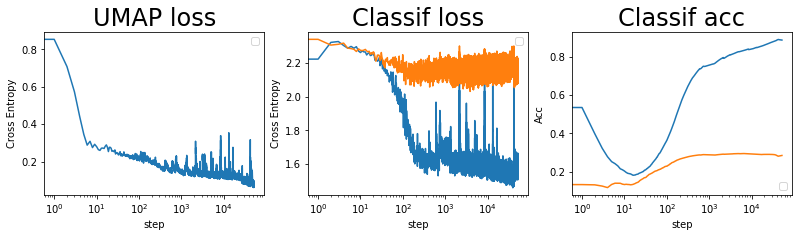

batch: 52000 | train acc: 0.8872 | val acc: 0.2849


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



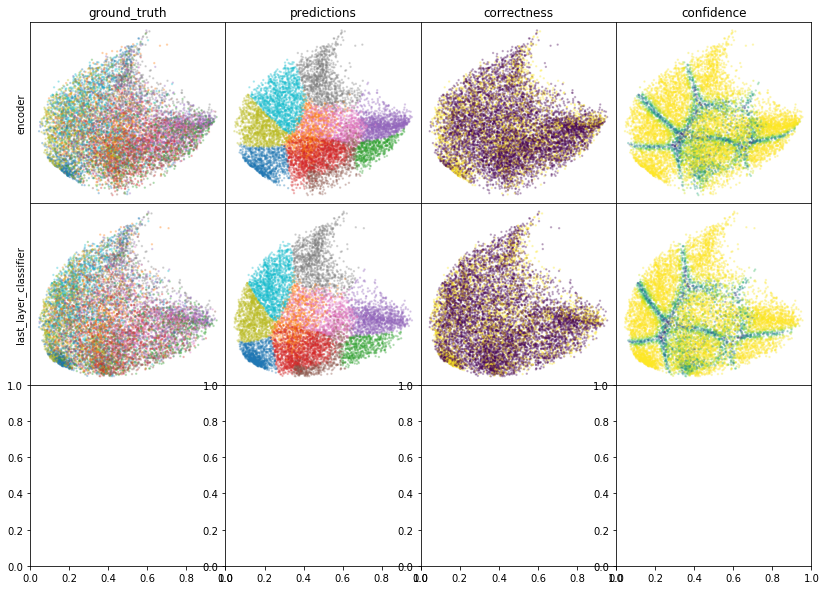

W0807 03:55:37.820092 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:55:38.082674 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 03:55:38.312235 139864680597248 legend.py:1282] No handles with labels found to put in legend.


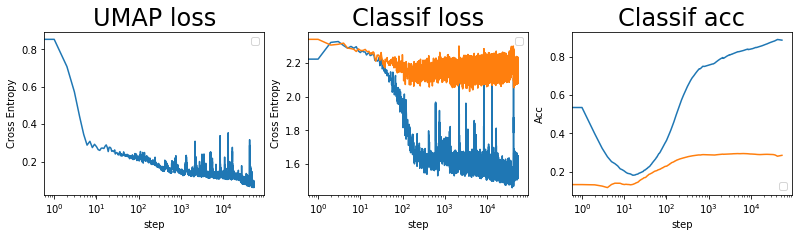

batch: 54000 | train acc: 0.8868 | val acc: 0.2855


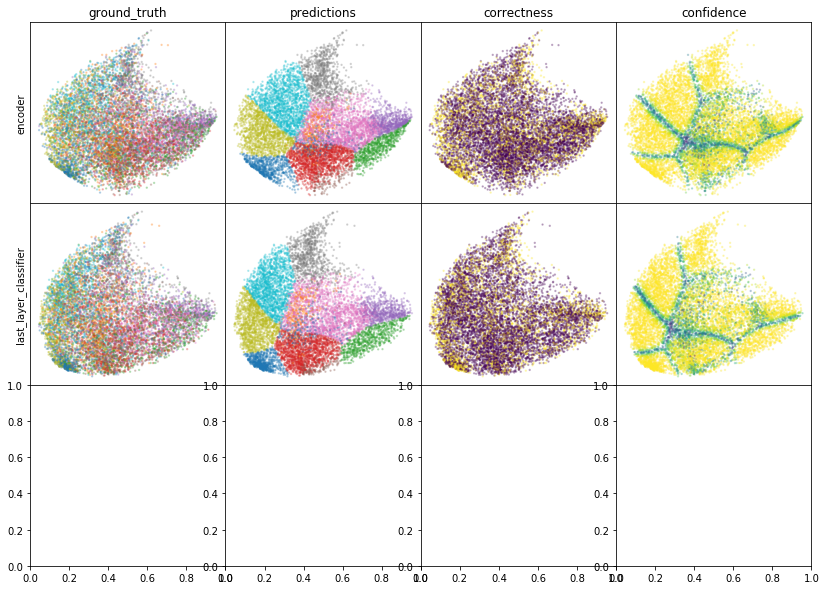

W0807 04:00:33.334840 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:00:33.610578 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:00:33.854601 139864680597248 legend.py:1282] No handles with labels found to put in legend.


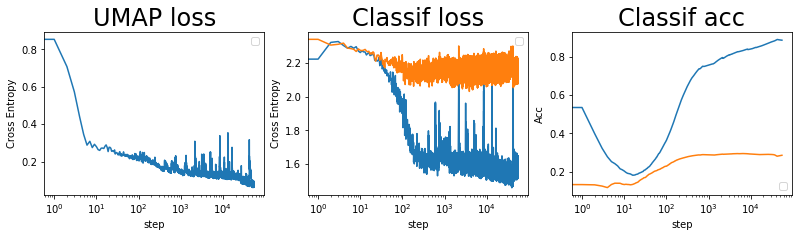

batch: 55000 | train acc: 0.8865 | val acc: 0.2858


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



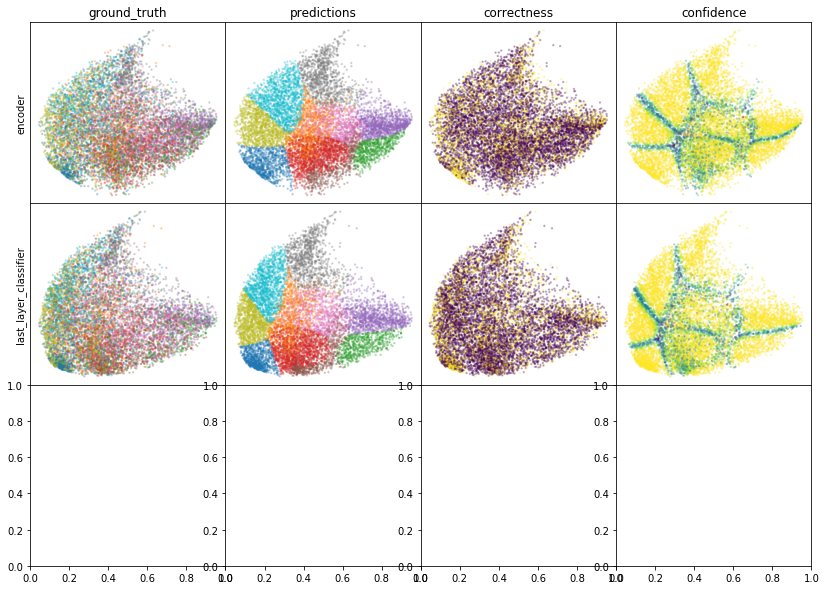

W0807 04:10:18.029597 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:10:18.280503 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:10:18.517229 139864680597248 legend.py:1282] No handles with labels found to put in legend.


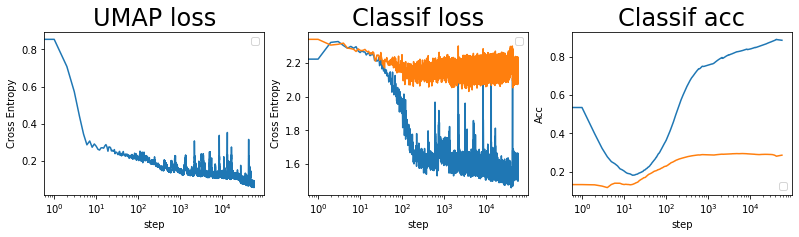

batch: 57000 | train acc: 0.8861 | val acc: 0.2863
leaving epoch because no improvement in 10000 batches


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



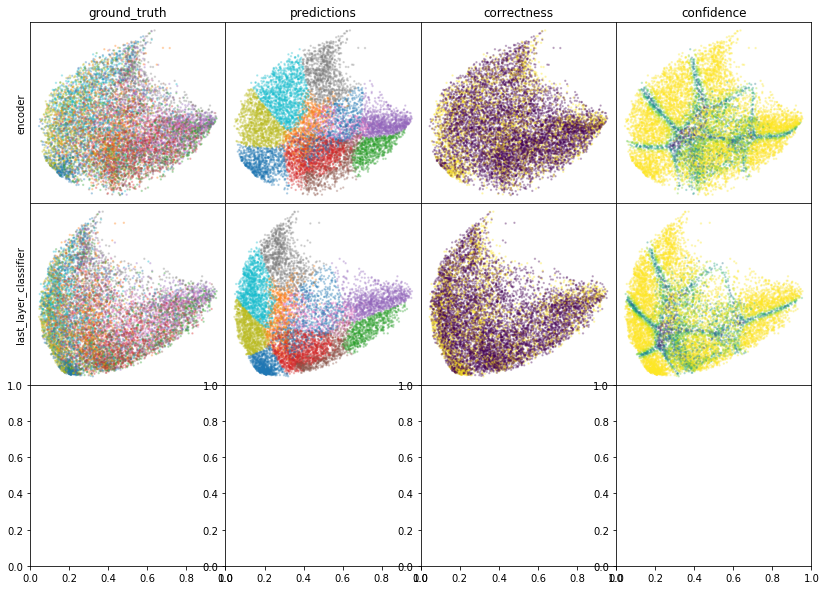

W0807 04:24:34.783013 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:24:35.050004 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:24:35.303273 139864680597248 legend.py:1282] No handles with labels found to put in legend.


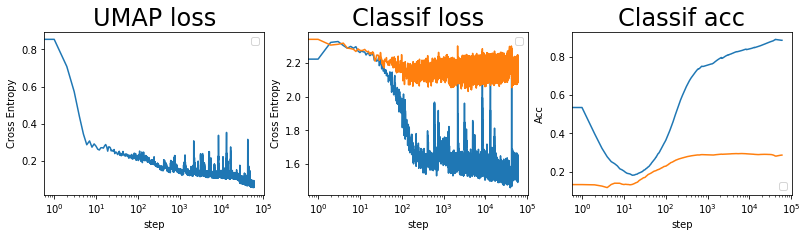

batch: 60000 | train acc: 0.886 | val acc: 0.2868


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



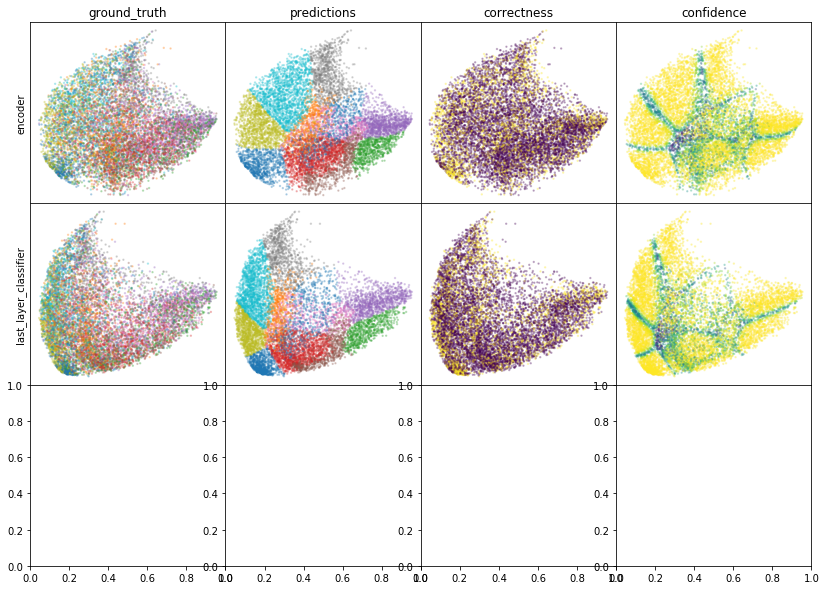

W0807 04:39:06.607281 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:39:06.894147 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:39:07.153612 139864680597248 legend.py:1282] No handles with labels found to put in legend.


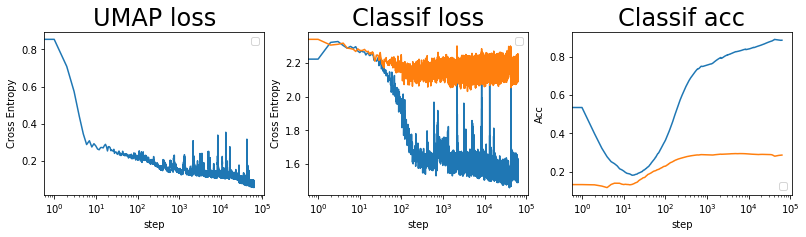

batch: 63000 | train acc: 0.8864 | val acc: 0.2869


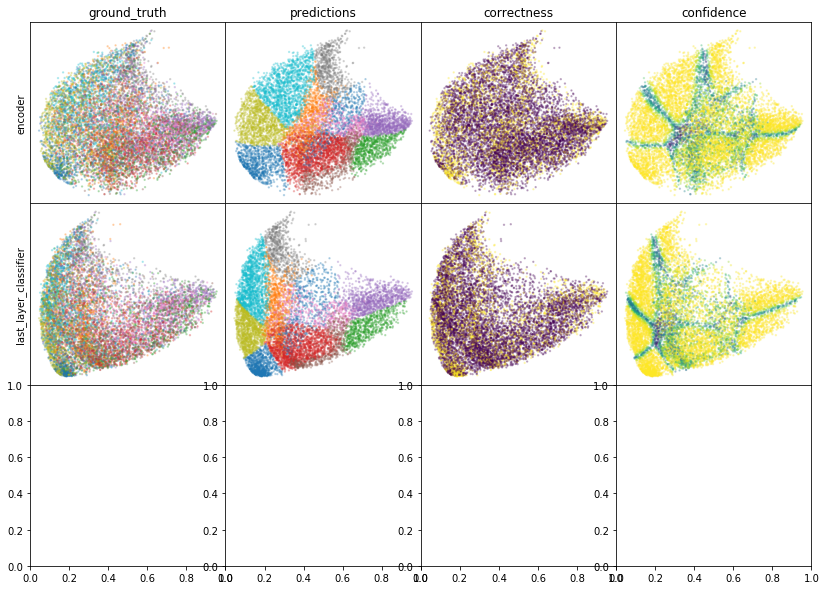

W0807 04:44:00.337801 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:44:00.605774 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:44:00.863020 139864680597248 legend.py:1282] No handles with labels found to put in legend.


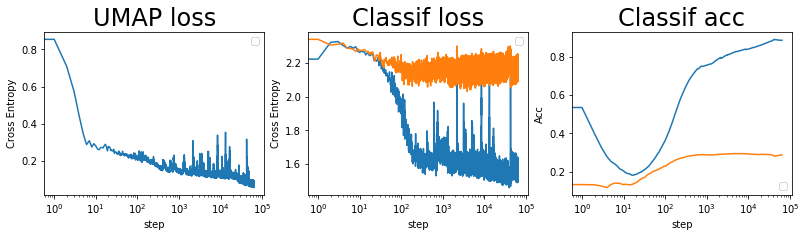

batch: 64000 | train acc: 0.8865 | val acc: 0.287


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



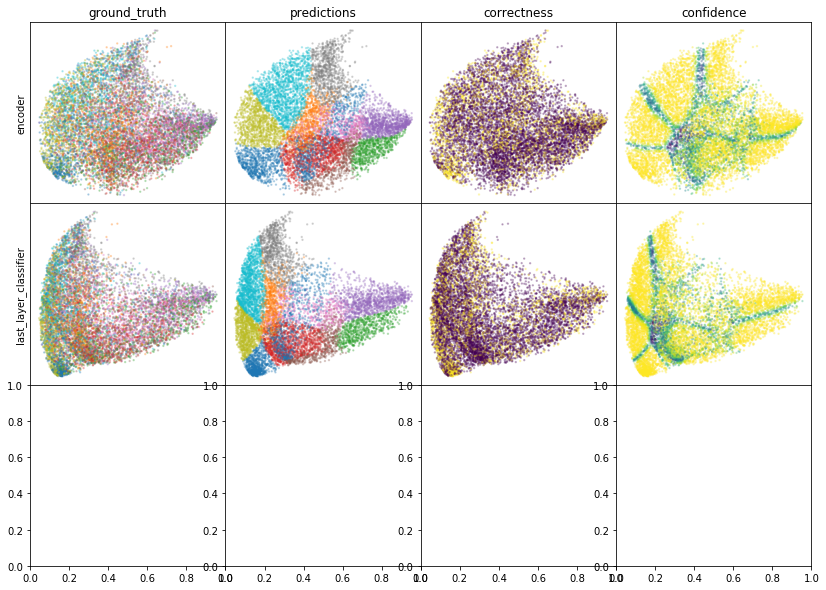

W0807 04:58:33.623214 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:58:33.901835 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 04:58:34.165916 139864680597248 legend.py:1282] No handles with labels found to put in legend.


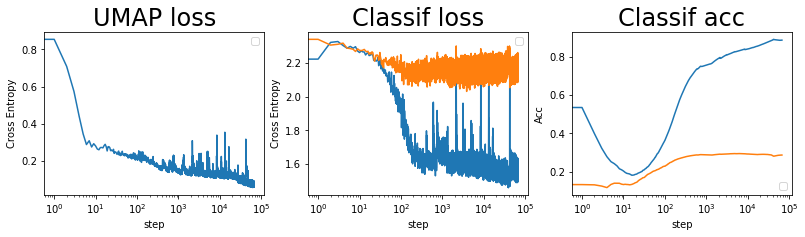

batch: 67000 | train acc: 0.8868 | val acc: 0.287
leaving epoch because no improvement in 10000 batches


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



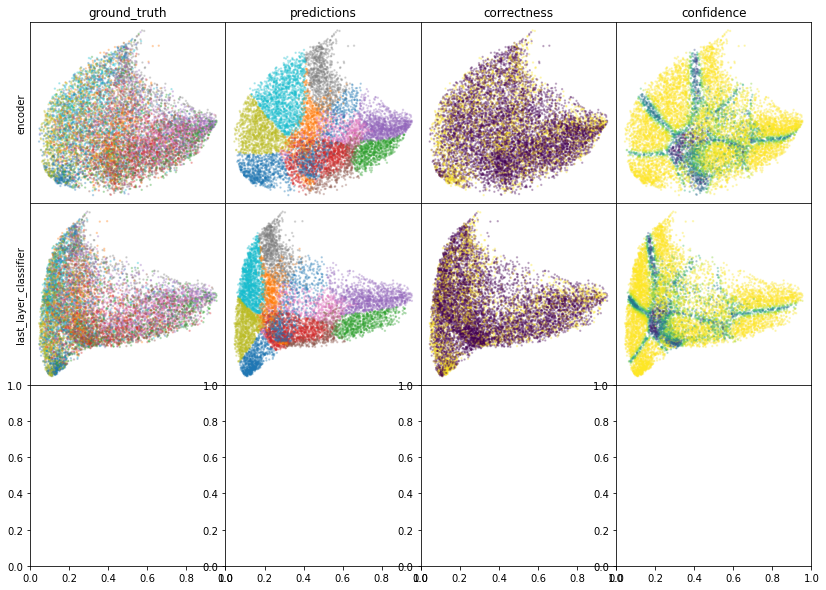

W0807 05:13:41.055279 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:13:41.346179 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:13:41.619384 139864680597248 legend.py:1282] No handles with labels found to put in legend.


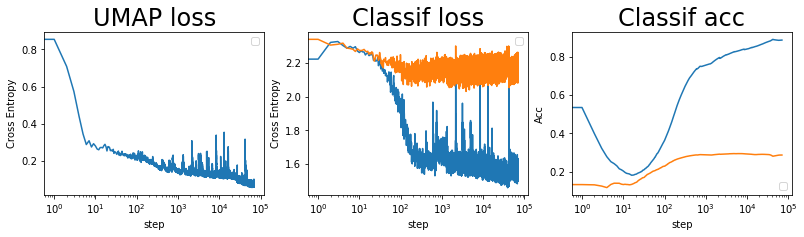

batch: 70000 | train acc: 0.8871 | val acc: 0.2871


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



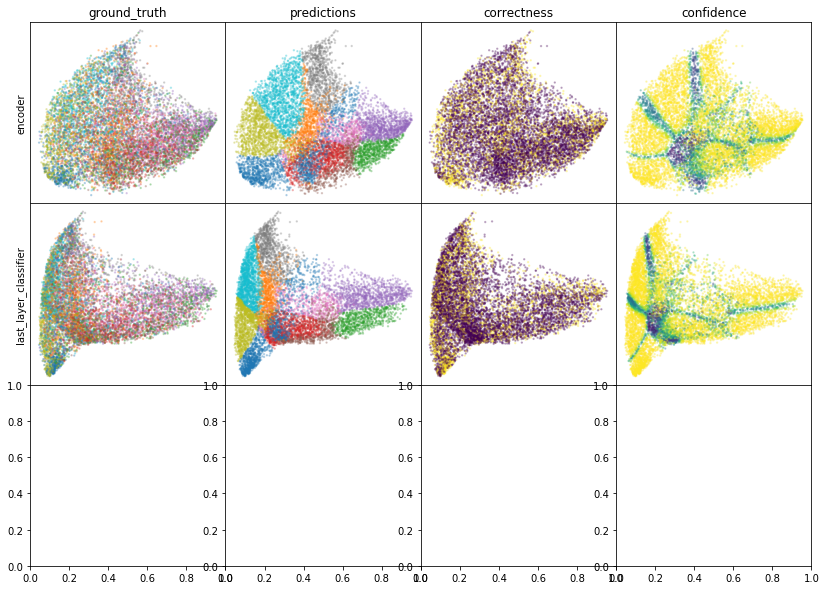

W0807 05:27:54.760417 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:27:55.062016 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:27:55.341996 139864680597248 legend.py:1282] No handles with labels found to put in legend.


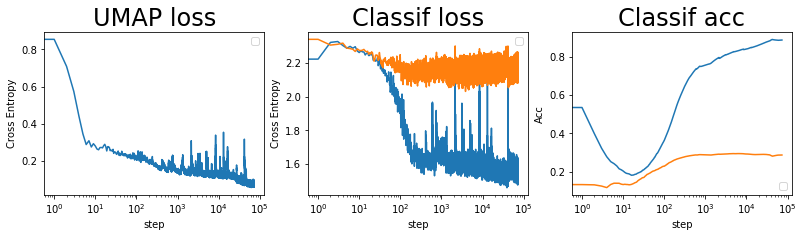

batch: 73000 | train acc: 0.8874 | val acc: 0.2873


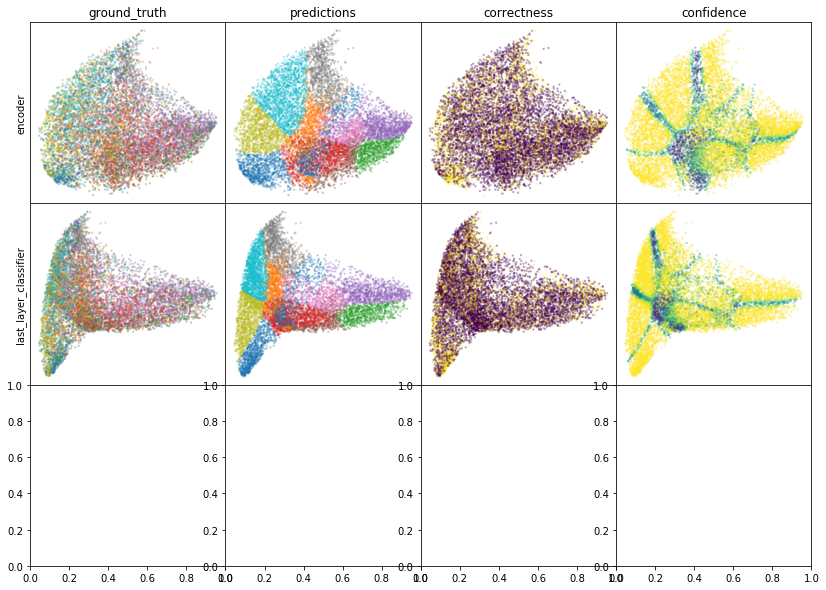

W0807 05:31:43.657963 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:31:43.962708 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:31:44.258440 139864680597248 legend.py:1282] No handles with labels found to put in legend.


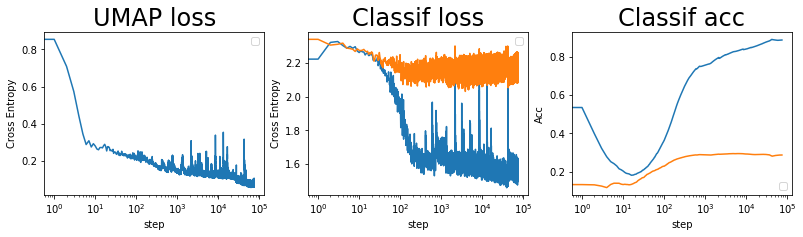

batch: 74000 | train acc: 0.8875 | val acc: 0.2873


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



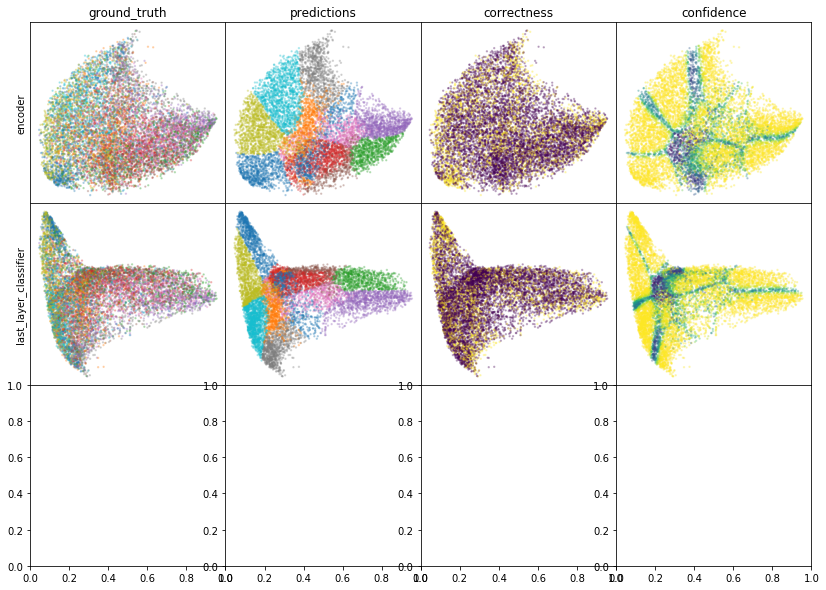

W0807 05:42:57.031737 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:42:57.345751 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 05:42:57.640765 139864680597248 legend.py:1282] No handles with labels found to put in legend.


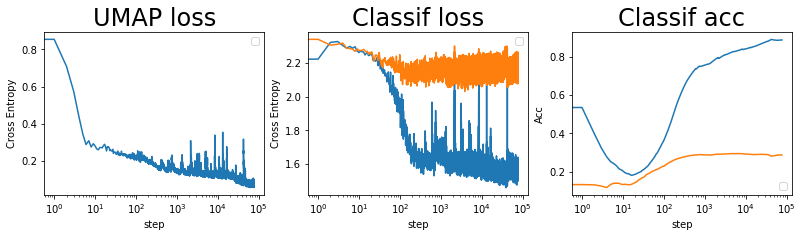

batch: 77000 | train acc: 0.8877 | val acc: 0.2874
leaving epoch because no improvement in 10000 batches
Early stopping because no improvement in 5 epochs


In [46]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(next(edge_epoch), labeled_iter, data_valid):
        
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train[np.array(batch_to)], batch_from=X_train[np.array(batch_from)], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [61]:
test_enc = model_data(X_test, batch_size, model.encoder)

In [62]:
y_pred = model_data(test_enc, batch_size, model.classifier)

In [63]:
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.301


In [64]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [65]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Fri Aug  7 15:18:08 2020 Finding Nearest Neighbors
Fri Aug  7 15:18:08 2020 Building RP forest with 15 trees
Fri Aug  7 15:18:08 2020 parallel NN descent for 15 iterations
	 0  /  15
	 1  /  15
Fri Aug  7 15:18:09 2020 Finished Nearest Neighbor Search
Fri Aug  7 15:18:10 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Aug  7 15:18:50 2020 Finished embedding


In [57]:
batch_to

<tf.Tensor: shape=(256,), dtype=int32, numpy=
array([25839, 10855,  3665, 39667,  7267, 15704, 37871, 19197, 14523,
       38359,  5423, 27455, 22442,  1882, 18705, 39152, 19461, 28382,
       23655, 15264, 27800, 32027, 11003, 27938, 11305, 37140, 24867,
       24855, 30754, 37807, 13446,  7436, 12181,  6165,  6328, 18734,
        1210, 14182, 17465,  5300, 10356,  1519, 19119, 10678, 35438,
       22661, 20584, 12087, 32342,  9499, 33397, 20515, 25500,   460,
       24234, 36106, 24061, 28651, 27531, 29927, 12775, 32663, 27606,
       13667, 13138, 31439,  9538, 24052, 19111, 13801,  2408, 21972,
       16341, 37002, 11562,  6991, 18654, 20139, 31927, 20785, 21884,
       25685, 32294,   958, 30015, 39691,  8680, 33609, 39601, 16685,
       36531,  8644,  5243, 36846, 18825,  6808, 33301, 33412, 29620,
        2522, 23191, 32994,  3926,  1440, 19385, 13731, 27110,  9601,
        5936,   111, 30077, 39225,  8378,  5501, 35017,  3543,  1297,
       24725,  2144, 24360, 19594,  1768,  8

In [58]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.2907


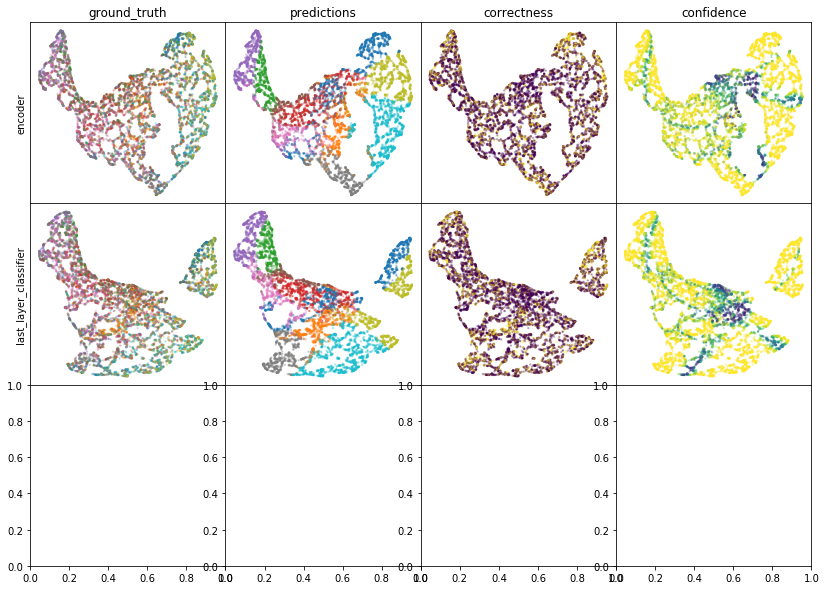

W0807 08:04:35.076350 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 08:04:35.518388 139864680597248 legend.py:1282] No handles with labels found to put in legend.
W0807 08:04:35.939619 139864680597248 legend.py:1282] No handles with labels found to put in legend.


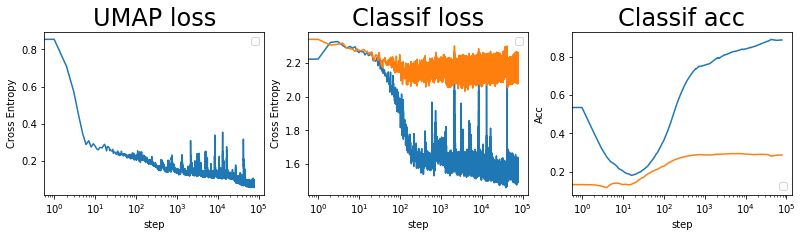

In [59]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')